# ERA5 Land Soil Water Levels

In [1]:
from pathlib import Path
import numpy as np 
import xarray as xr 
import matplotlib.pyplot as plt
import seaborn as sns
import warnings 
import pandas as pd

import sys
sys.path.append("/home/tommy/neuralhydrology")
from scripts.read_nh_results import (
    get_test_filepath,
    get_all_station_ds,
    calculate_all_error_metrics,
    get_ensemble_path,
)

from scripts.read_model import (get_model, _load_weights)
from scripts.read_nh_results import (read_multi_experiment_results, calculate_member_errors)
from neuralhydrology.utils.config import Config

%load_ext autoreload
%autoreload 2

In [2]:
data_dir = Path("/datadrive/data")
run_dir = data_dir / "runs/complexity_AZURE/hs_064_0306_205514"
out_dir = run_dir / "cell_states"

In [3]:
import geopandas as gpd
from scripts.geospatial import initialise_gb_spatial_plot, load_latlon_points
from mpl_toolkits.axes_grid1 import make_axes_locatable

points = load_latlon_points(data_dir)
static = xr.open_dataset(data_dir / "camels_static.nc")

ds = xr.open_dataset(data_dir / "RUNOFF/ALL_dynamic_ds.nc")

In [4]:
cfg = Config(run_dir / "config.yml")

# Input / Target Data

In [5]:
from scripts.cell_state.utils import (
    read_basin_list, 
    get_train_test_cell_states, 
    normalize_and_convert_dimension_to_variable_for_cell_state_data, 
    create_train_test_default_dict_for_all_target_vars, 
    train_and_evaluate_models
)

In [6]:
TARGET = "ERA5"
PER_BASIN = False
NORM = True
SHORT_TRAIN = True

## Get training/test dataset

In [7]:
train_sids = read_basin_list(cfg.train_basin_file)
test_sids = read_basin_list(cfg.test_basin_file)
train_ds = ds.sel(time=slice(cfg.train_start_date, cfg.train_end_date), station_id=np.isin(ds.station_id, train_sids.station_id))
test_ds = ds.sel(time=slice(cfg.test_start_date, cfg.test_end_date), station_id=np.isin(ds.station_id, test_sids.station_id))

out_of_sample = not all(np.isin(test_sids, train_sids))
print(f"Out of Sample: {not all(np.isin(test_sids, train_sids))}")

Out of Sample: False


## Probe the basins

In [8]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

train_cn, test_cn = get_train_test_cell_states(run_dir, cfg)

# Normalisation strategy - global or local?

In [9]:
cn = xr.concat([train_cn, test_cn], dim="date")
cn_station_mean_ = train_cn.mean(dim="date")
cn_station_std_ = train_cn.std(dim="date")
station_norm_cn = (cn - cn_station_mean_) / cn_station_std_

In [10]:
from scripts.cell_state.utils import normalize_and_convert_dimension_to_variable_for_cell_state_data


train_cs, (mean_, std_) = normalize_and_convert_dimension_to_variable_for_cell_state_data(
    cn=train_cn,
    out_dir=out_dir, 
    per_basin=PER_BASIN,
    train_test="train",
    time_dim="date",
    reload=True
)

test_cs, (mean_, std_) = normalize_and_convert_dimension_to_variable_for_cell_state_data(
    cn=test_cn,
    out_dir=out_dir, 
    per_basin=PER_BASIN,
    train_test="test",
    time_dim="date",
    reload=True,
    mean_=mean_,
    std_=std_
)

print("DONE")

Calculating Normalisation for `train` data: global
Calculating Normalisation for `test` data: global
DONE


In [11]:
train_cs["station_id"] = train_cs["station_id"].astype(int)
test_cs["station_id"] = test_cs["station_id"].astype(int)

train_cs = train_cs if (not "date" in train_cs.coords) else train_cs.rename({"date": "time"})
test_cs = test_cs if (not "date" in test_cs.coords) else test_cs.rename({"date": "time"})

In [12]:
if SHORT_TRAIN:
    train_cs = train_cs.sel(time=slice("01-01-1988", "12-31-1997"))
    
SHORT_TRAIN

True

# Target Data

In [13]:
from scripts.cell_state.normalize import normalize_2d_dataset


if TARGET == "ERA5":
    filepath = data_dir / "camels_basin_ERA5Land_sm.nc"
    era5_ds = xr.open_dataset(filepath)

    if not isinstance(era5_ds, xr.Dataset):
        era5_ds = era5_ds.to_dataset()
    
    if NORM:
        for var in era5_ds.data_vars:
            era5_ds[var] = normalize_2d_dataset(era5_ds, variable_str=var, per_basin=PER_BASIN)

    era5_ds["station_id"] = era5_ds["station_id"].astype(int)

    # NOT for snow depth ..?
    target_ds = era5_ds.drop("sd").copy()

elif TARGET == "ESA":
    filepath = data_dir / "SOIL_MOISTURE/interp_full_timeseries_esa_cci_sm.nc"
    esa_ds = xr.open_dataset(filepath).drop("spatial_ref")
    if not isinstance(esa_ds, xr.Dataset):
        esa_ds = esa_ds.to_dataset()

    if NORM:
        for var in era5_ds.data_vars:
            era5_ds[var] = normalize_2d_dataset(era5_ds, variable_str=var, per_basin=PER_BASIN)

    esa_ds["station_id"] = esa_ds["station_id"].astype(int)
    target_ds = esa_ds
else:
    assert False
    
print(f"Loaded {TARGET} data with " + f"{'local' if PER_BASIN else 'global'} Normalisation" if NORM else "no Normalisation")

Loaded ERA5 data with global Normalisation


In [14]:
[
    f"{target_var}: {float(target_ds[target_var].min()):.2f}: {float(target_ds[target_var].max()):.2f}" 
    for target_var in target_ds.data_vars
]

['swvl1: -3.45: 4.41',
 'swvl2: -3.62: 4.58',
 'swvl3: -2.81: 4.46',
 'swvl4: -2.28: 4.75']

# Probes Train

In [15]:
train_target_ds = target_ds.sel(station_id=np.isin(target_ds.station_id, train_cs.station_id), time=np.isin(target_ds.time, train_cs.time))
test_target_ds = target_ds.sel(station_id=np.isin(target_ds.station_id, test_cs.station_id), time=np.isin(target_ds.time, test_cs.time))

input_variables = list(train_cs.data_vars)
seq_length = 1
basin_dim = "station_id"
time_dim = "time"

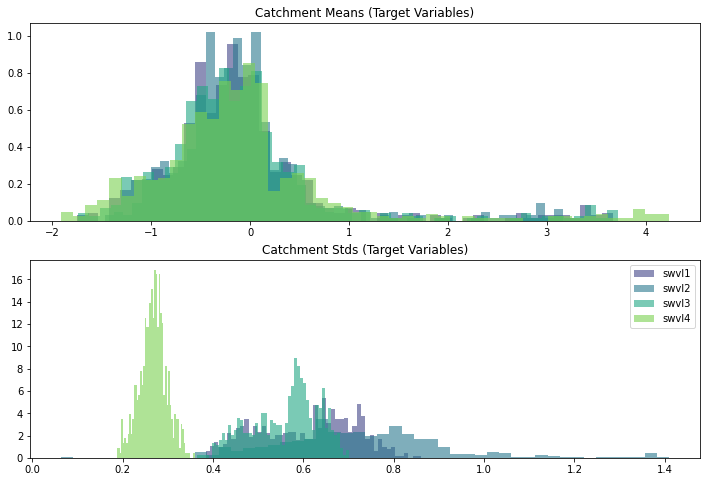

In [16]:
f, axs = plt.subplots(2, 1, figsize=(12, 8))
target_vars = list(train_target_ds.data_vars)
colors = sns.color_palette("viridis", n_colors=len(target_vars))

for ix, target_var in enumerate(target_vars):
    axs[0].hist(train_target_ds.mean(dim="time")[target_var], color=colors[ix], alpha=0.6, bins=50, density=True)
    axs[0].set_title("Catchment Means (Target Variables)")
    axs[1].hist(train_target_ds.std(dim="time")[target_var], color=colors[ix], alpha=0.6, bins=50, density=True, label=target_var)
    axs[1].set_title("Catchment Stds (Target Variables)")
    axs[1].legend()

In [17]:
import pickle
filepath = data_dir / "all_train_test.pkl"
RELOAD = True

if not (filepath).exists() or not RELOAD:
    all_train_test = create_train_test_default_dict_for_all_target_vars(
        train_cs=train_cs,
        test_cs=test_cs,
        train_target_ds=train_target_ds,
        test_target_ds=test_target_ds,
        input_variables=input_variables,
    )
    with filepath.open("wb") as f:
        pickle.dump(all_train_test, f)
else:
    all_train_test = pickle.load((data_dir / "all_train_test.pkl").open("rb"))

In [18]:
# lin_models_preds = train_and_evaluate_models(all_train_test, sgd=False)

In [19]:
all_models_preds = train_and_evaluate_models(all_train_test, sgd=True)

** swvl1 linear model **
-- Epoch 1
Norm: 0.87, NNZs: 41, Bias: -0.031065, T: 2192295, Avg. loss: 0.038744
Total training time: 1.51 seconds.
-- Epoch 2
Norm: 0.87, NNZs: 41, Bias: -0.024247, T: 4384590, Avg. loss: 0.038674
Total training time: 3.19 seconds.
-- Epoch 3
Norm: 0.87, NNZs: 42, Bias: -0.026209, T: 6576885, Avg. loss: 0.038671
Total training time: 4.87 seconds.
-- Epoch 4
Norm: 0.87, NNZs: 43, Bias: -0.020924, T: 8769180, Avg. loss: 0.038668
Total training time: 6.53 seconds.
Convergence after 4 epochs took 6.70 seconds


Calculating Errors: 100%|██████████| 667/667 [00:14<00:00, 45.30it/s, 106001]




** swvl2 linear model **
-- Epoch 1
Norm: 0.74, NNZs: 37, Bias: -0.045405, T: 2192953, Avg. loss: 0.046205
Total training time: 1.55 seconds.
-- Epoch 2
Norm: 0.75, NNZs: 35, Bias: -0.040136, T: 4385906, Avg. loss: 0.046153
Total training time: 3.26 seconds.
-- Epoch 3
Norm: 0.74, NNZs: 38, Bias: -0.045445, T: 6578859, Avg. loss: 0.046149
Total training time: 4.95 seconds.
-- Epoch 4
Norm: 0.74, NNZs: 37, Bias: -0.042281, T: 8771812, Avg. loss: 0.046149
Total training time: 6.66 seconds.
Convergence after 4 epochs took 6.83 seconds


Calculating Errors: 100%|██████████| 667/667 [00:14<00:00, 45.06it/s, 106001]




** swvl3 linear model **
-- Epoch 1
Norm: 0.85, NNZs: 40, Bias: -0.037897, T: 2192295, Avg. loss: 0.036639
Total training time: 1.55 seconds.
-- Epoch 2
Norm: 0.85, NNZs: 40, Bias: -0.036722, T: 4384590, Avg. loss: 0.036564
Total training time: 3.28 seconds.
-- Epoch 3
Norm: 0.85, NNZs: 40, Bias: -0.036686, T: 6576885, Avg. loss: 0.036565
Total training time: 4.99 seconds.
-- Epoch 4
Norm: 0.85, NNZs: 40, Bias: -0.034173, T: 8769180, Avg. loss: 0.036560
Total training time: 6.68 seconds.
Convergence after 4 epochs took 6.84 seconds


Calculating Errors: 100%|██████████| 667/667 [00:14<00:00, 45.29it/s, 106001]




** swvl4 linear model **
-- Epoch 1
Norm: 0.84, NNZs: 39, Bias: -0.066900, T: 2192295, Avg. loss: 0.037871
Total training time: 1.53 seconds.
-- Epoch 2
Norm: 0.84, NNZs: 39, Bias: -0.065497, T: 4384590, Avg. loss: 0.037791
Total training time: 3.22 seconds.
-- Epoch 3
Norm: 0.84, NNZs: 39, Bias: -0.062453, T: 6576885, Avg. loss: 0.037794
Total training time: 4.92 seconds.
-- Epoch 4
Norm: 0.84, NNZs: 39, Bias: -0.056859, T: 8769180, Avg. loss: 0.037785
Total training time: 6.64 seconds.
Convergence after 4 epochs took 6.80 seconds


Calculating Errors: 100%|██████████| 667/667 [00:14<00:00, 45.45it/s, 106001]


In [20]:
for var in [v for v in all_train_test.keys()]:
    pass

all_train_test[var]["train"]["X"].shape

(2435884, 64)

# Explore results

### plot timeseries

In [21]:
q90 = all_models_preds["swvl1"]["errors"]["NSE"].quantile(q=0.9)
q70 = all_models_preds["swvl1"]["errors"]["NSE"].quantile(q=0.7)
q40 = all_models_preds["swvl1"]["errors"]["NSE"].quantile(q=0.4)
q10 = all_models_preds["swvl1"]["errors"]["NSE"].quantile(q=0.1)
preds = all_models_preds["swvl4"]["preds"]

group1 = all_models_preds["swvl1"]["errors"]["NSE"].where(all_models_preds["swvl1"]["errors"]["NSE"] > q90, drop=True).station_id.values
group2 = all_models_preds["swvl1"]["errors"]["NSE"].where(
    (all_models_preds["swvl1"]["errors"]["NSE"] <= q70) & (all_models_preds["swvl1"]["errors"]["NSE"] > q40), 
    drop=True
).station_id.values
group3 = all_models_preds["swvl1"]["errors"]["NSE"].where(all_models_preds["swvl1"]["errors"]["NSE"] < q10, drop=True).station_id.values


station_medians = preds["obs"].median(dim="time")
max_station = station_medians.where(station_medians == station_medians.max(dim="station_id"), drop=True)["station_id"].values
min_station = station_medians.where(station_medians == station_medians.min(dim="station_id"), drop=True)["station_id"].values
med_station = station_medians.where(station_medians == station_medians.median(dim="station_id"), drop=True)["station_id"].values

pixels = [int(min_station), int(med_station), int(max_station)]
pixels

[33032, 39108, 85003]

In [22]:
metric = "NSE"
errors = all_models_preds["swvl4"]["errors"]
errors_metric = errors[metric]
max_station_err = errors_metric.where(errors_metric == errors_metric.max(dim="station_id"), drop=True)["station_id"].values
min_station_err = errors_metric.where(errors_metric == errors_metric.min(dim="station_id"), drop=True)["station_id"].values
med_station_err = errors_metric.where(errors_metric == errors_metric.median(dim="station_id"), drop=True)["station_id"].values

pixels_err = [int(min_station_err), int(med_station_err), int(max_station_err)]
pixels_err

[18017, 74007, 27087]

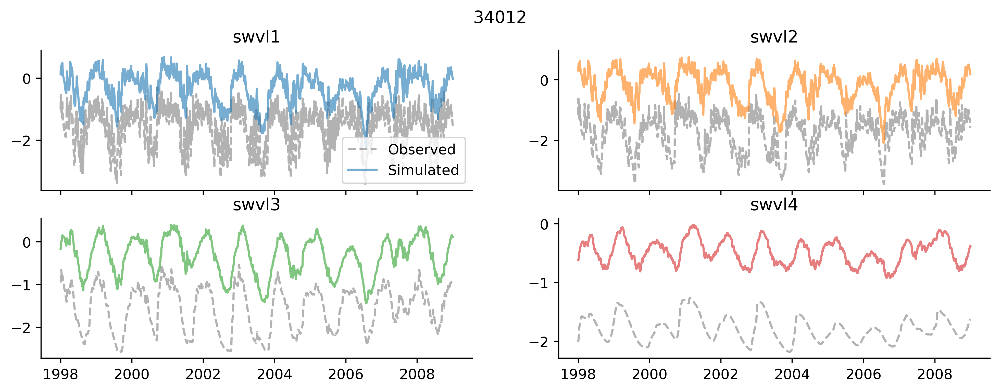

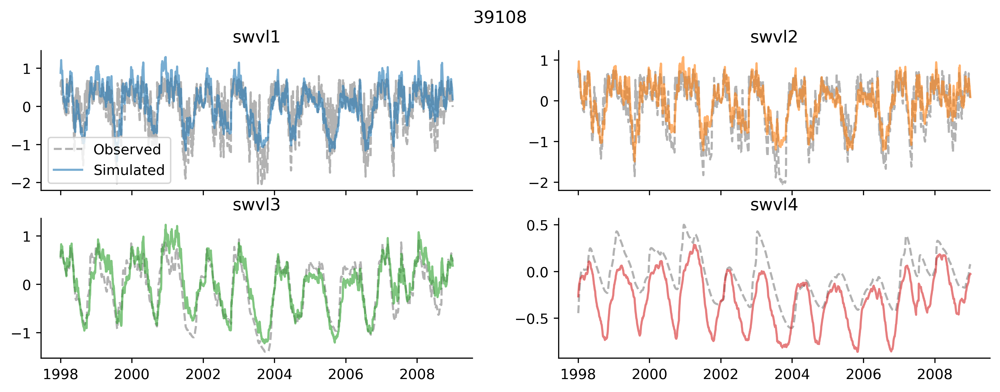

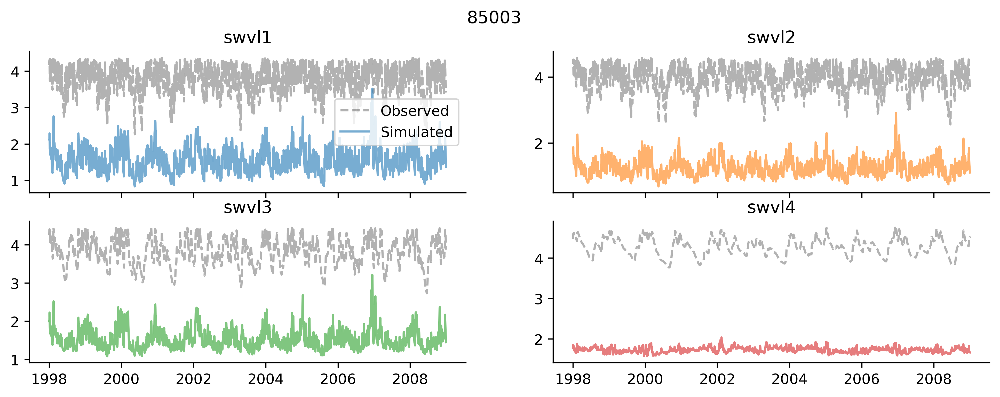

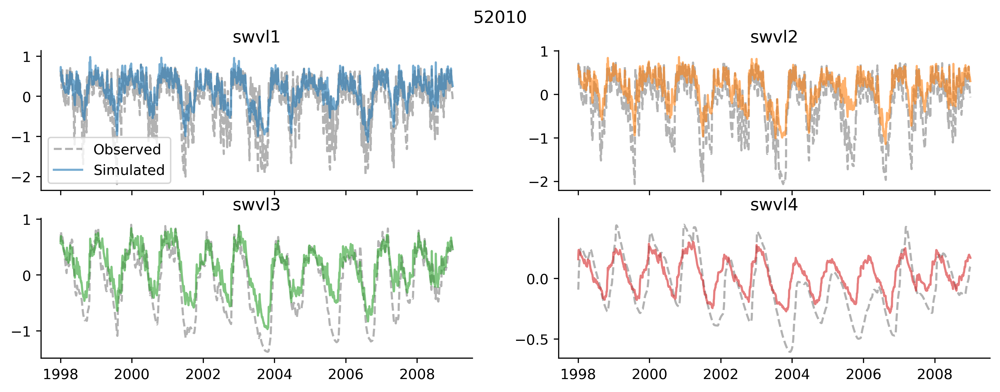

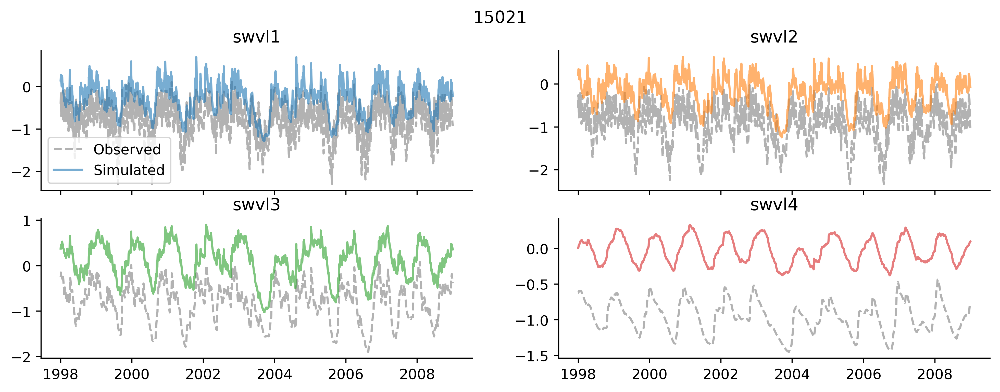

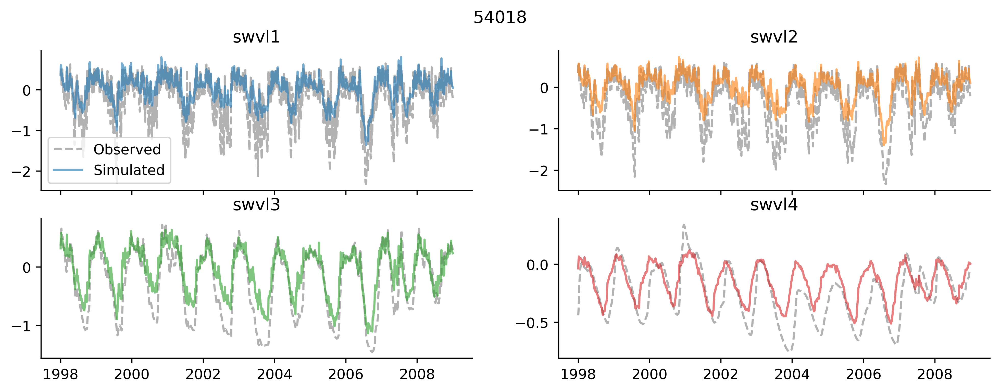

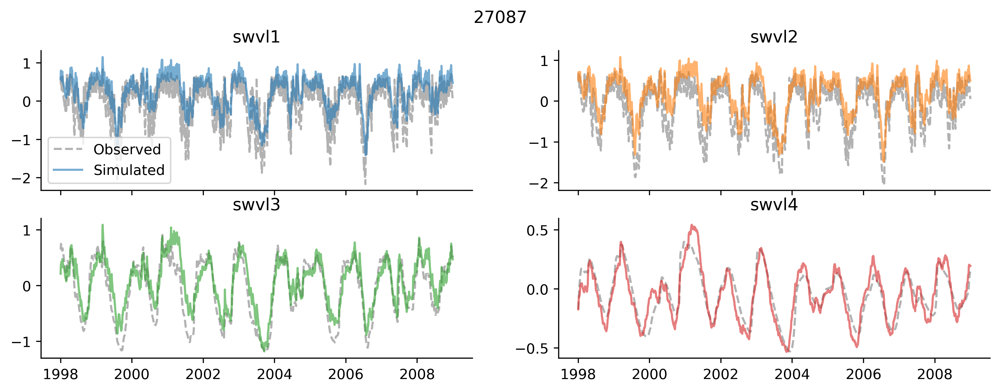

In [23]:
p = all_models_preds["swvl1"]["preds"]
time = slice("2000", "2007")
time = slice("1998", "2008")

N = 3
# pixels = np.random.choice(p.station_id.values, N, replace=False)
# pixels = np.concatenate(
#     [np.random.choice(group1, 1, replace=False),
#     np.random.choice(group2, 1, replace=False),
#     np.random.choice(group3, 1, replace=False),]
# )
# pixels = [27030, 38012, 39017]
# pixels = [61001, 14001, 95001]
# pixels = [34012, 52010, 85003]
# pixels = [54018, 15021, 48003]
pixels = [33032, 39108, 85003]
pixels = [34012, 39108, 85003, 52010, 15021, 54018, 27087]
# pixels = pixels_err
# pixels = [2002, 72005, 15030]
# pixels = [int(min_station), int(med_station), int(max_station)]

target_vars = [f"swvl{ix+1}" for ix in range(4)]

with plt.rc_context({"figure.dpi": 400}):
    for px in pixels:
        f, axs = plt.subplots(2, 2, figsize=(12, 4), sharex=True)
        for ix, target_var in enumerate(target_vars):
            ax = axs[np.unravel_index(ix, (2, 2))]
            preds = all_models_preds[target_var]["preds"]
            data = preds.sel(station_id=px, time=time)

        #     f, ax = plt.subplots(figsize=(12, 4))
            ax.plot(data.time, data.obs, color="k", ls="--", alpha=0.3, label="Observed")
#             ax = ax.twinx()
            ax.plot(data.time, data.sim, color=f"C{ix}", ls="-", alpha=0.6, label="Simulated")
            ax.set_title(f"{target_var}")
            if ix == 0:
                ax.legend()
            sns.despine()
        f.suptitle(px)

In [24]:
if False:
    # check spatial performance of plots
    # does not work in SCOTLAND [wet] or SE ENGLAND/E ANGLIA [dry]
    f, axs = plt.subplots(2, 2, figsize=(5*2, 8*2))
    metric = "NSE"

    for ix, var_ in enumerate(target_vars):
        ax = axs[np.unravel_index(ix, (2, 2))]
        err_ = all_models_preds[var_]["errors"]
        initialise_gb_spatial_plot(ax=ax)
        _gdf = gpd.GeoDataFrame(err_[metric].to_dataframe().join(points))
        _gdf.plot(metric, ax=ax, vmin=0, legend=True, vmax=0.5)

### plot histograms

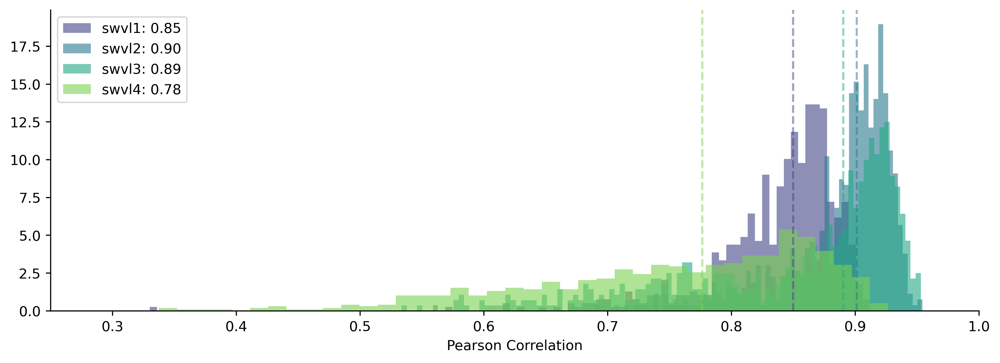

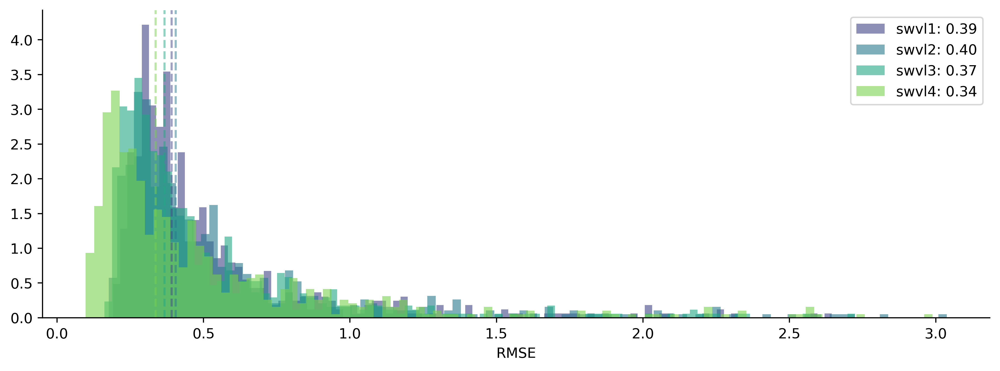

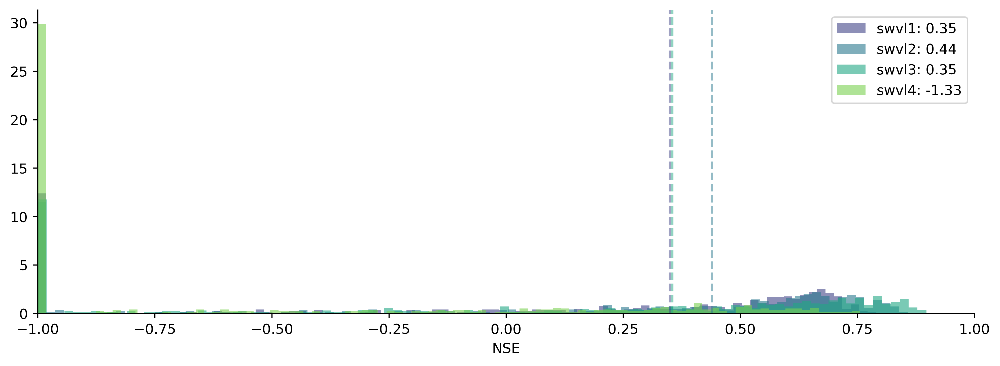

In [25]:
for metric in ["Pearson-r", "RMSE", "NSE"]:

    with plt.rc_context({'figure.dpi': 400}):
        f, ax = plt.subplots(figsize=(12, 4))

        #  metric = "Pearson-r"
        colors = sns.color_palette("viridis", n_colors=len(target_vars))
        for ix, target_var in enumerate(target_vars):
            errors = all_models_preds[target_var]["errors"]
            nse = errors[metric]

            ax.hist(nse.where(nse > -1, -1), bins=100, density=True, label=f"{target_var}: {nse.median().values:.2f}", alpha=0.6, color=colors[ix]);
            ax.axvline(nse.median(), color=colors[ix], ls="--", alpha=0.5)
        ax.set_xlabel(metric if metric != "Pearson-r" else "Pearson Correlation")
        ax.set_xlim(0.25, 1) if metric in ["Pearson-r"] else None
        ax.set_xlim(-1, 1) if metric in ["NSE"] else None
        ax.legend()
        sns.despine()

In [26]:
# with plt.rc_context({'figure.dpi': 400}):
#     f, ax = plt.subplots(figsize=(12, 4))

#     metric = "RMSE"
#     colors = sns.color_palette("viridis", n_colors=len(target_vars))
#     for ix, target_var in enumerate(target_vars):
#         errors = all_models_preds[target_var]["errors"]
#         nse = errors[metric]

#         ax.hist(nse.where(nse > -1, -1), bins=100, density=True, label=f"{target_var}: {nse.median().values:.2f}", alpha=0.6, color=colors[ix]);
#         ax.axvline(nse.median(), color=colors[ix], ls="--", alpha=0.5)
#     ax.set_xlabel(metric if metric != "Pearson-r" else "Pearson Correlation")
#     ax.set_xlim(0, 1)
#     ax.legend()
#     sns.despine()

In [27]:
# with plt.rc_context({'figure.dpi': 400}):
#     f, ax = plt.subplots(figsize=(12, 4))

#     metric = "NSE"
#     colors = sns.color_palette("viridis", n_colors=len(target_vars))
#     for ix, target_var in enumerate(target_vars):
#         errors = all_models_preds[target_var]["errors"]
#         nse = errors[metric]

#         ax.hist(nse.where(nse > -1, -1), bins=100, density=True, label=f"{target_var}: {nse.median().values:.2f}", alpha=0.6, color=colors[ix]);
#         ax.axvline(nse.median(), color=colors[ix], ls="--", alpha=0.5)
#     ax.set_xlabel(metric if metric != "Pearson-r" else "Pearson Correlation")
#     ax.set_xlim(-1, 1)
#     ax.legend()
#     sns.despine()

### plot the weights

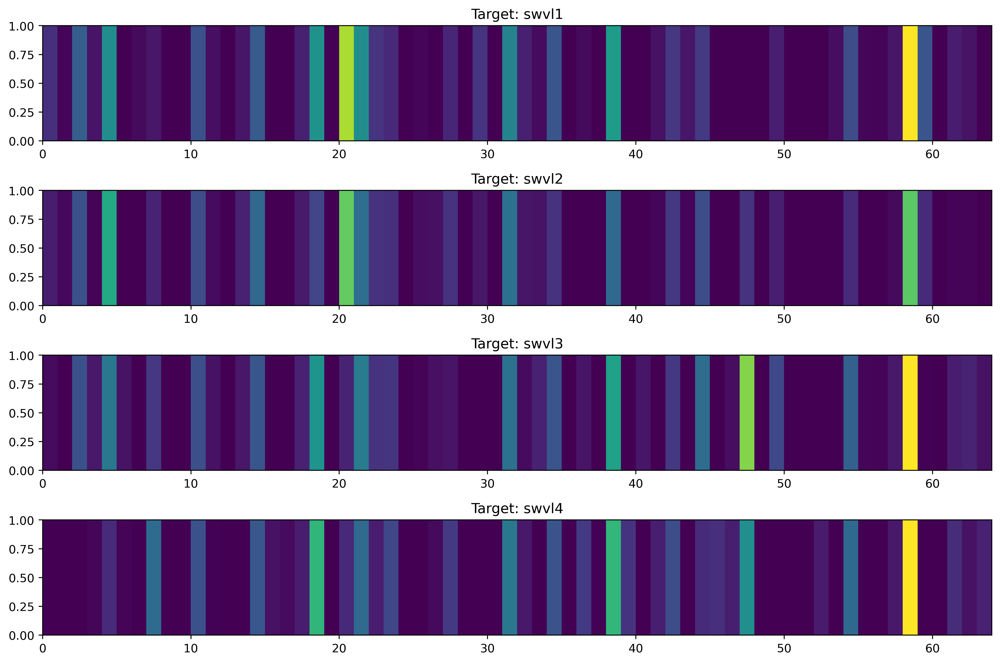

In [28]:
from scripts.cell_state.analysis import get_model_weights, plot_weights

target_vars = [f"swvl{ix+1}" for ix in range(4)]
with plt.rc_context({'figure.dpi': 400}):
    n_plots = len(target_vars)
    f, axs = plt.subplots(n_plots, 1, figsize=(12, 2*n_plots))

    for ix, target_var in enumerate(target_vars):
        model = all_models_preds[target_var]["model"]
        ax = axs[ix]
        w, b = get_model_weights(model)
        plot_weights(np.abs(w), kwargs={"vmin": 0., "vmax": 0.3}, ax=ax, cbar=False)
        ax.set_title(f"Target: {target_var}")
    plt.tight_layout()

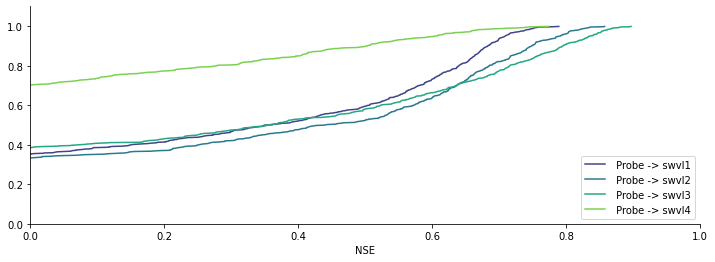

In [29]:
from typing import Any, Dict
import seaborn as sns
import matplotlib.pyplot as plt


def empirical_cdf(errors: np.ndarray, kwargs: Dict[str, Any] = {}):
    x = np.sort(errors)
    y = np.arange(len(x))/float(len(x))
    plt.plot(x, y, **kwargs)

    
f, ax = plt.subplots(figsize=(12, 4))
colors = sns.color_palette("viridis", n_colors=len(target_vars))
for ix, target_var in enumerate(target_vars):
    errors = all_models_preds[target_var]["errors"]
    nse = errors["NSE"]
    empirical_cdf(nse, kwargs={"label": f" Probe -> {target_var}", "color": colors[ix]})

ax.set_xlim(0, 1)
ax.set_ylim(0, 1.1)
ax.set_xlabel("NSE")
plt.legend()
sns.despine()

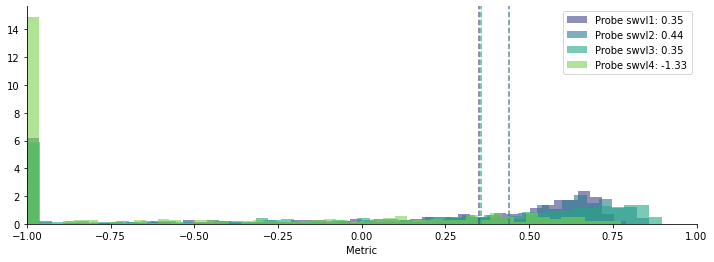

In [30]:
from scripts.cell_state.analysis import histogram_plot

f, ax = plt.subplots(1, 1, figsize=(12, 4))

colors = sns.color_palette("viridis", 4)
for ix, target_var in enumerate(target_vars):
    errors = all_models_preds[target_var]["errors"]
    arr = errors["NSE"]
    med = np.median(arr)
    histogram_plot(np.clip(arr, -1, 1), hist_kwargs={"color": colors[ix], "label": f"Probe {target_var}: {med:.2f}"}, ax=ax)
ax.set_title("")
ax.set_xlim(-1, 1)
ax.legend()

# Scatter plots showing relationships

In [186]:
float_vars = np.array(static.data_vars)[([static[var].dtype == "float64" for var in static.data_vars])]
static["p_mean"]
[v for v in float_vars if "soil" in v]

['soil_depth_pelletier',
 'soil_depth_pelletier_missing',
 'soil_depth_pelletier_5',
 'soil_depth_pelletier_50',
 'soil_depth_pelletier_95']

In [205]:
metric = "Beta-NSE"
metric = "Pearson-r"
err = all_models_preds["swvl1"]["errors"][metric]
err_abs = np.abs(err)

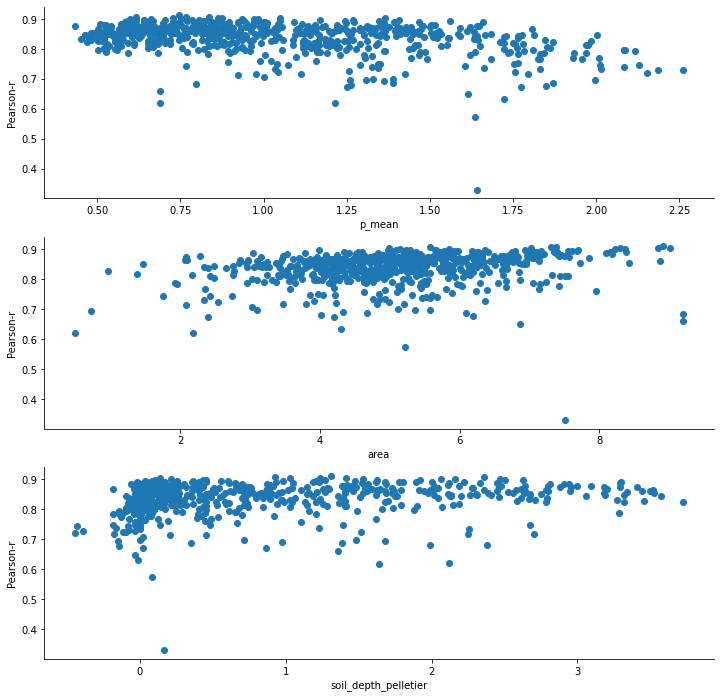

In [206]:
var = "p_mean"
vars_ = ["log_p_mean", "log_area", "log_soil_depth_pelletier"]

f, axs = plt.subplots(len(vars_), 1, figsize=(12, 4*len(vars_)))
for ix, var in enumerate(vars_):
    ax = axs[ix]
    
    if "log_" in var:
        var = var.replace("log_", "")
        stat = np.log(static[var].sel(station_id=bias.station_id))
    else:
        stat = static[var].sel(station_id=bias.station_id)
    ax.scatter(stat, err)
    ax.set_xlabel(var)
    ax.set_ylabel(metric)
sns.despine()

# What about spatial results

In [227]:
pre = all_models_preds["swvl4"]["preds"]
err = all_models_preds["swvl4"]["errors"]
err["abs_Beta-NSE"] = np.abs(err["Beta-NSE"])
N = 20
metric = "abs_Beta-NSE"

SMALLEST = False
if SMALLEST:
    n_catchments = err.sortby(metric)[metric][:N].station_id
else:
    n_catchments = err.sortby(metric)[metric][-N:].station_id

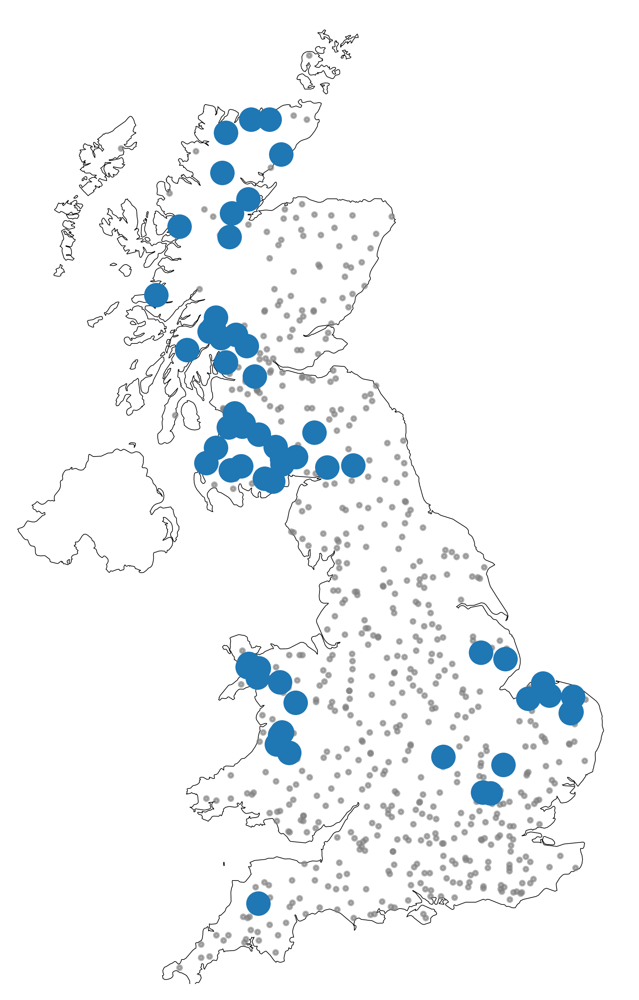

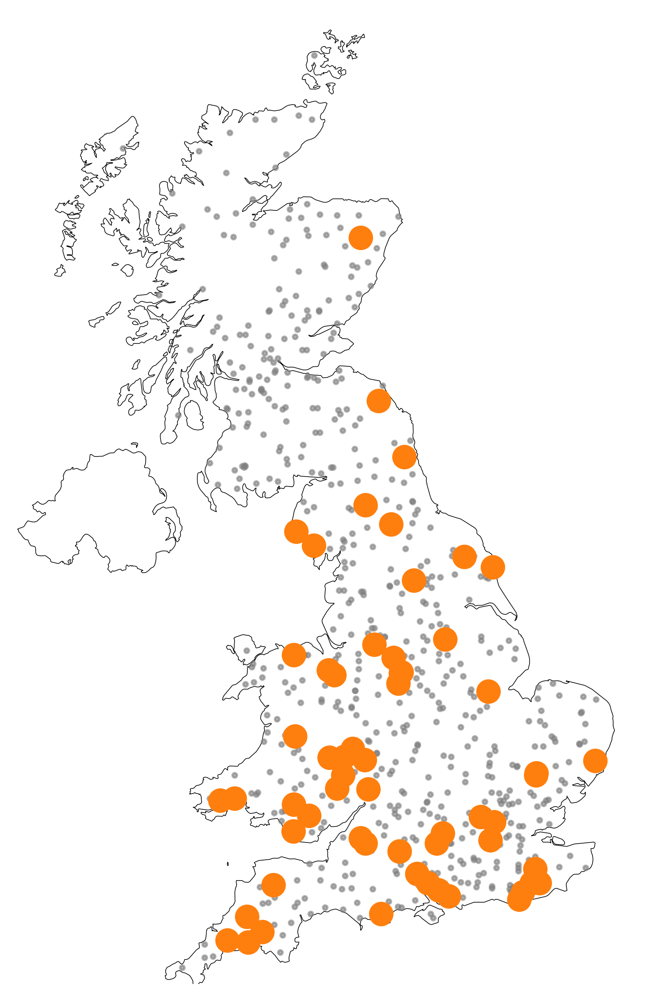

In [255]:
from scripts.geospatial import plot_spatial_location


N = 60

high_bias = err.sortby(metric)[metric][-N:].station_id
low_bias = err.sortby(metric)[metric][:N].station_id

with plt.rc_context({"figure.dpi": 400}):
    plot_spatial_location(high_bias, points)
    ax = plt.gca()

    plot_spatial_location(low_bias, points, plot_kwargs=dict(color="C1"))
    ax = plt.gca()


array([[<AxesSubplot:title={'center':'log_p_mean'}>,
        <AxesSubplot:title={'center':'log_area'}>],
       [<AxesSubplot:title={'center':'log_pet_mean'}>,
        <AxesSubplot:title={'center':'log_soil_depth_pelletier'}>]],
      dtype=object)

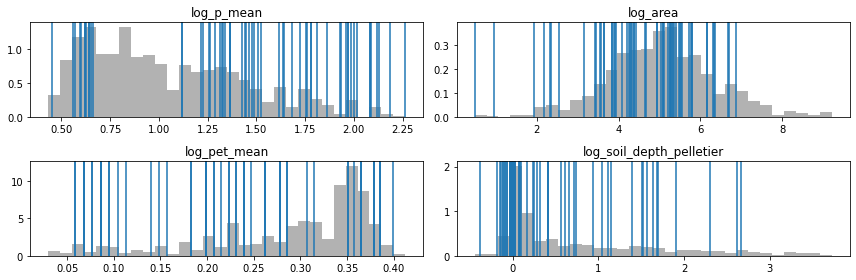

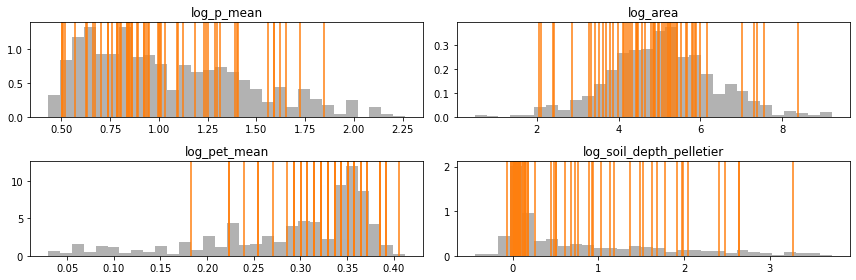

In [236]:
log_static = static.copy()
log_static["log_p_mean"] = np.log(static["p_mean"])
log_static["log_area"] = np.log(static["area"])
log_static["log_pet_mean"] = np.log(static["pet_mean"])
log_static["log_soil_depth_pelletier"] = np.log(static["soil_depth_pelletier"])

plot_context(log_static, variables=["log_p_mean", "log_area", "log_pet_mean", "log_soil_depth_pelletier"], sids=high_bias, axvline_kwargs={"color": "C0"})
plot_context(log_static, variables=["log_p_mean", "log_area", "log_pet_mean", "log_soil_depth_pelletier"], sids=low_bias, axvline_kwargs={"color": "C1"})

### what about just precipitation?

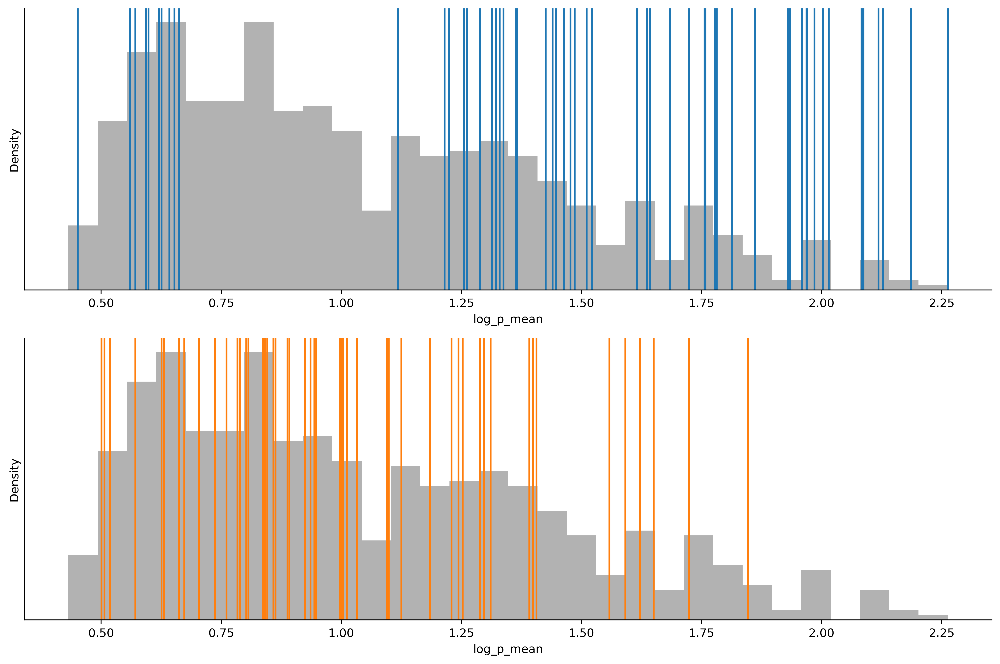

In [256]:
var_ = "log_p_mean"

with plt.rc_context({"figure.dpi": 400}):
    f, axs = plt.subplots(2, 1, figsize=(12, 8), tight_layout=True)

    sids = high_bias
    portions = ["Largest", "Smallest"]

    for ix, sids in enumerate([high_bias, low_bias]):
        axvline_kwargs = dict(color=f"C{ix}")
        ax = axs[ix]
        ax.hist(static[var_], color="grey", alpha=0.6, bins=30, density=True)
        ax.set_xlabel(var_)
        ax.set_yticks([])
        ax.set_yticklabels([])
        ax.set_ylabel("Density")

        if sids is not None:
            for sid in sids:
                ax.axvline(static[var_].sel(station_id=sid), **axvline_kwargs)

#         ax.set_title(f"{portions[ix]} 60 {metric}")


sns.despine()

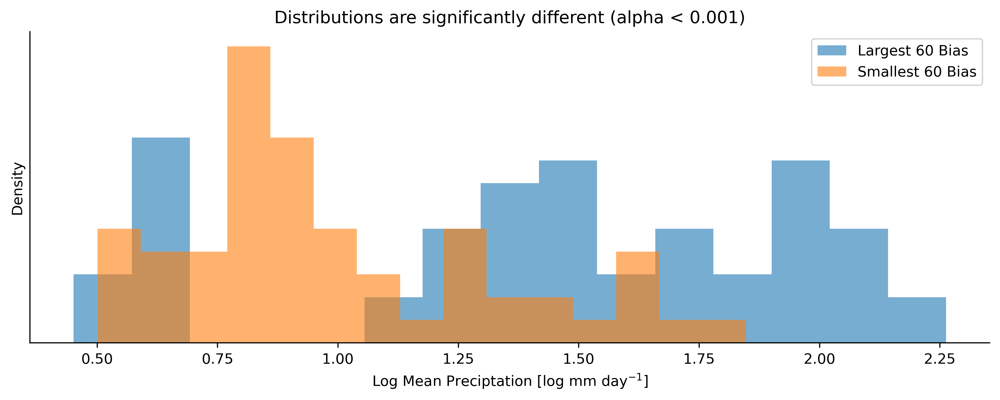

In [304]:
from scipy.stats import ks_2samp
var_ = "log_p_mean"

static[var_].sel(station_id=high_bias).values
static[var_].sel(station_id=low_bias).values

hi, lo = static[var_].sel(station_id=high_bias).values, static[var_].sel(station_id=low_bias).values
stat = ks_2samp(hi, lo)


with plt.rc_context({"figure.dpi": 400}):
    f, ax = plt.subplots(figsize=(12, 4))
    ax.hist(hi, label="Largest 60 Bias", alpha=0.6, bins=15)
    ax.hist(lo, label="Smallest 60 Bias", alpha=0.6, bins=15)
    
    ax.legend()
    ax.set_yticks([])
    ax.set_yticklabels([])
    ax.set_xlabel("Log Mean Preciptation [log mm day$^{-1}$]")
    ax.set_ylabel("Density")
    ax.set_title(f"Distributions are significantly different (alpha < 0.001)")
    sns.despine()

In [300]:
from scipy.stats import ks_2samp

stat = ks_2samp(hi, lo)
f"Alpha < 0.001: {stat.pvalue < 0.001}"

'Alpha < 0.001: True'

KstestResult(statistic=0.0, pvalue=1.0)

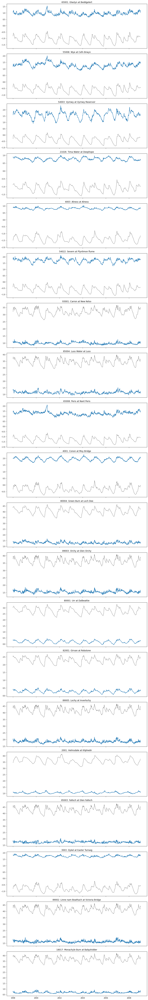

In [216]:
TWIN = False

f, axs = plt.subplots(len(n_catchments), 1, figsize=(12, 4*N), sharex=True, tight_layout=True)
data = pre.sel(station_id=n_catchments)

for ix, sid in enumerate(data.station_id):
    ax = axs[ix]
    d = data.sel(station_id=sid)
    ax.plot(d["time"], d["obs"], color="k", ls="--", alpha=0.6)
    
    if TWIN:
        ax = ax.twinx()
    ax.plot(d["time"], d["sim"], color="C0")
    ax.set_title(f"{int(sid)}: " + str(static.sel(station_id=sid)["gauge_name"].values))

## Scatter Plots

In [257]:
log_static["log_p_mean"]

<xarray.DataArray 'log_p_mean' (station_id: 671)>
array([0.97455964, 1.11841492, 1.22671229, 1.68454538, 1.61541998,
       1.36353737, 1.79508726, 1.83258146, 1.84845481, 1.64287269,
       1.31372367, 1.22964055, 1.09861229, 0.85866162, 0.89199804,
       1.00063188, 1.1249296 , 1.30562646, 1.1568812 , 1.04027671,
       1.02245093, 1.30291275, 0.9439059 , 0.91629073, 0.97832612,
       1.07500242, 0.82855182, 0.83724752, 0.90016135, 0.98954119,
       0.89199804, 1.16002092, 1.13462273, 1.43746265, 1.04380405,
       1.327075  , 1.16938136, 1.2781522 , 0.90421815, 1.25561604,
       0.79299252, 1.13140211, 1.16315081, 0.82417544, 0.82855182,
       0.71783979, 1.42551507, 1.74221902, 1.15057203, 1.76644166,
       1.46787435, 1.40118297, 1.20597081, 1.83258146, 0.93609336,
       1.35066718, 2.00821403, 1.18784342, 0.85015093, 1.327075  ,
       1.48387469, 1.7227666 , 1.41098697, 1.5040774 , 1.22082992,
       0.9282193 , 1.05431203, 1.25846099, 1.04731899, 1.41098697,
       1.36097655, 1.7647308 , 1.86097454, 1.5623463 , 1.64093658,
       1.36863943, 1.96990565, 1.84213568, 0.96317432, 0.91228271,
       0.76546784, 0.78845736, 1.11185752, 0.54232429, 0.70803579,
       0.77010822, 1.19088756, 1.20896035, 0.98954119, 1.00063188,
       1.34547237, 1.22671229, 0.95935022, 0.85441533, 0.71783979,
       1.64093658, 1.00430161, 0.82417544, 0.62593843, 0.9282193 ,
...
       1.24990174, 1.44926916, 1.5518088 , 1.33762919, 1.28923265,
       1.20597081, 1.53471437, 1.58514522, 1.75093747, 1.83258146,
       1.50851199, 2.08567209, 1.16315081, 1.84687877, 1.59127394,
       1.61143592, 1.87026253, 1.76644166, 1.72455072, 1.13462273,
       1.62136648, 1.16002092, 1.2029723 , 1.10525683, 1.21491274,
       1.44456327, 1.44220199, 1.32175584, 1.22082992, 1.35325451,
       1.44691898, 1.51732262, 1.43983513, 1.4861397 , 1.5539252 ,
       1.42551507, 1.4632554 , 1.36353737, 1.64287269, 2.01223279,
       1.98513086, 1.99605993, 1.97685495, 1.64865863, 1.46556754,
       1.35325451, 1.78170913, 1.66013103, 1.36609165, 1.47704872,
       1.32972401, 1.28923265, 1.25561604, 1.34547237, 1.4929041 ,
       1.36097655, 1.26129787, 1.30291275, 1.26976054, 1.19694819,
       1.26412673, 1.24990174, 1.3428648 , 1.18784342, 1.30833282,
       1.1442228 , 1.63705308, 1.25276297, 1.03318448, 1.521699  ,
       1.33762919, 1.45628673, 1.38879124, 1.78339122, 1.47247206,
       2.11866225, 1.93007109, 1.63705308, 2.18605128, 2.08442908,
       2.12823171, 2.00283044, 2.15292432, 2.08691356, 2.01490302,
       1.87026253, 1.82454929, 1.11841492, 1.33762919, 1.93441577,
       1.08856195, 0.83724752, 0.82855182, 1.0919233 , 1.42551507,
       1.15057203])
Coordinates:
  * station_id  (station_id) int64 1001 2001 2002 3003 ... 102001 106001 107001

# What about individual cell states?

In [34]:
def get_ws_bs_for_target_var(all_models_preds, target_var: str):
    model = all_models_preds[target_var]["model"]
    w, b = get_model_weights(model)
    return w, b

In [35]:
from scripts.cell_state.cell_state_dataset import dataset_dimensions_to_variable

station_norm_cs = dataset_dimensions_to_variable(
    station_norm_cn,
    variable="c_n",
    dimension_to_convert_to_variable_dim="dimension",
    time_dim="date"
)
station_norm_cs = station_norm_cs.rename({"date": "time"})
station_norm_cs["station_id"] = station_norm_cs["station_id"].astype(int)

In [36]:
max_idx = np.argmax(np.abs(w))


58


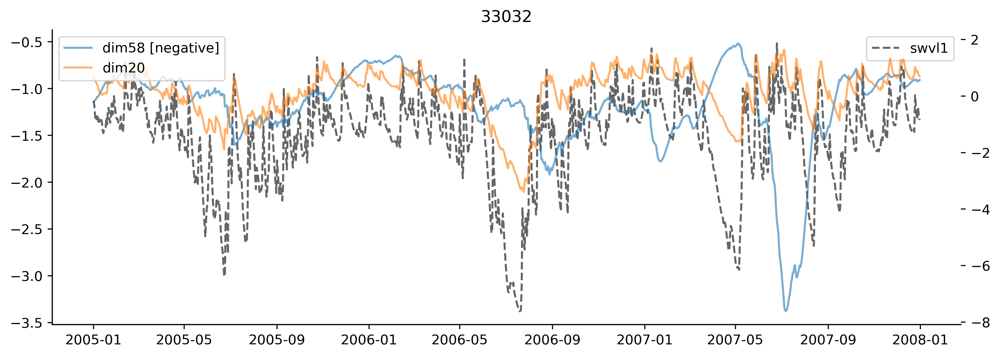

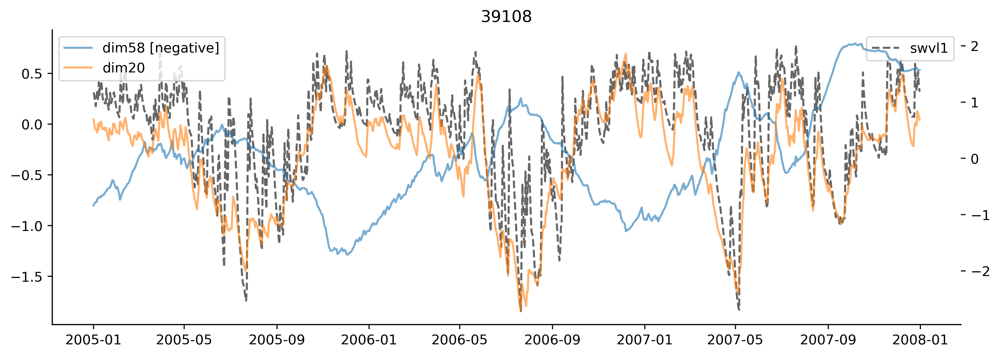

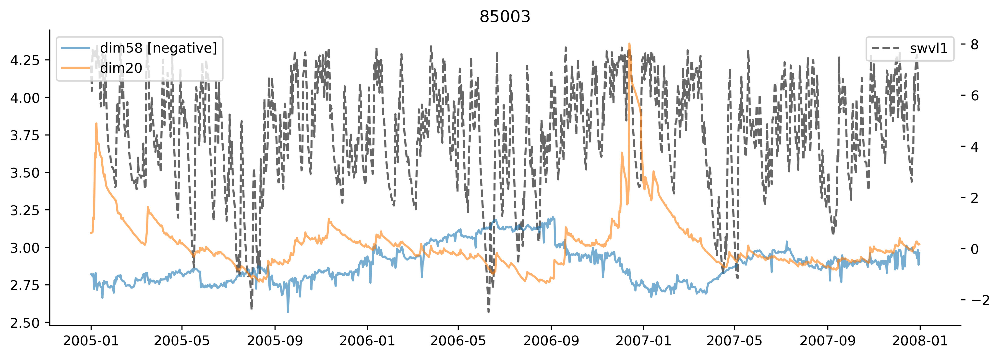

In [37]:
target_var = "7_day_smooth_sm" if TARGET == "ESA" else "swvl1"
# N_dims = 3
time = slice("2005", "2007")
Npxs = 2
N_dims = 2

w, b = get_ws_bs_for_target_var(all_models_preds, target_var)
max_idx = np.argmax(np.abs(w))
second_idx = np.argsort(np.abs(w))[-2]
print(max_idx)
largest_n = np.abs(w).argsort()[-N_dims:][::-1]
features = [f"dim{idx}" for idx in largest_n]

pxs = np.random.choice(test_cs.station_id.values, Npxs)
pxs = [15021, 54018]
# pxs = [61001, 14001, 95001]
# pxs = [33032, 39108, 85003]
pxs = [33032, 39108, 85003]

with plt.rc_context({"figure.dpi": 400}):
    for px in pxs:
        f, ax = plt.subplots(figsize=(12, 4))
        data = station_norm_cs.sel(station_id=px, time=time).to_dataframe()
        target = target_ds.sel(station_id=px, time=time).to_dataframe()

        ax.plot(target.index, target[target_var], label=target_var, color="k", ls="--", alpha=0.6)
        ax.legend(loc="upper right")
        ax.set_title(px)

        ax = ax.twinx()
        for ix, feature in enumerate([f"dim{max_idx}", f"dim{second_idx}"]):  # features  ["dim20"]  ["dim58"]
            weight = w[largest_n][ix]  #  ix  -1
            negative = -1 if weight < 0 else 1
            ax.plot(data.index, data[feature] * negative, label=f"{feature}{' [negative]' if negative == -1 else ''}", color=f"C{ix}", alpha=0.6)
            ax.legend(loc="upper left")

        sns.despine()

In [38]:
# w[np.argmax(np.abs(w))]
w[max_idx]
max_idx

58

In [39]:
dim = max_idx
sim = station_norm_cs[f"dim{dim}"]
obs = target_ds["swvl1"]

sim = sim.sel(
    station_id=np.isin(sim["station_id"], obs["station_id"]), time=np.isin(sim["time"], obs["time"])
).rename("sim")

obs = obs.sel(
    station_id=np.isin(obs["station_id"], sim["station_id"]), time=np.isin(obs["time"], sim["time"])
).rename("obs").drop("spatial_ref")

dimpred = xr.merge([sim, obs])
dimpred = dimpred.where(np.isfinite(dimpred).to_array().all(dim="variable"), drop=True)

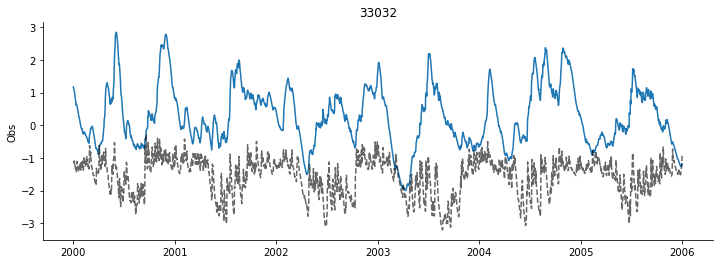

In [40]:
px = np.random.choice(dimpred.station_id.values)
pixels = [33032, 39108, 85003]
px = 33032

df = dimpred.sel(station_id=px).drop(["station_id"]).to_dataframe()
df = df.loc["2000": "2005"]

f, ax = plt.subplots(figsize=(12, 4))
ax.plot(df.index, df["sim"])
ax.set_ylabel(f"Sim [Dim{dim}]")

ax.plot(df.index, df["obs"], ls="--", color="k", alpha=0.6)
ax.set_ylabel("Obs")
ax.set_title(px)
sns.despine()

# Compare SWVL offsets 

In [41]:
target_var = "swvl4"
pixels = [54018, 15021, 48003]
pixels = [33032, 39108, 85003]
time = slice("1998", "2008")
preds = all_models_preds[target_var]["preds"]

In [42]:
station_medians = preds["obs"].median(dim="time")
max_station = station_medians.where(station_medians == station_medians.max(dim="station_id"), drop=True)["station_id"].values
min_station = station_medians.where(station_medians == station_medians.min(dim="station_id"), drop=True)["station_id"].values
med_station = station_medians.where(station_medians == station_medians.median(dim="station_id"), drop=True)["station_id"].values

pixels = [int(min_station), int(med_station), int(max_station)]
pixels

[33032, 39108, 85003]

In [43]:
data = preds.sel(station_id=pixels, time=time)

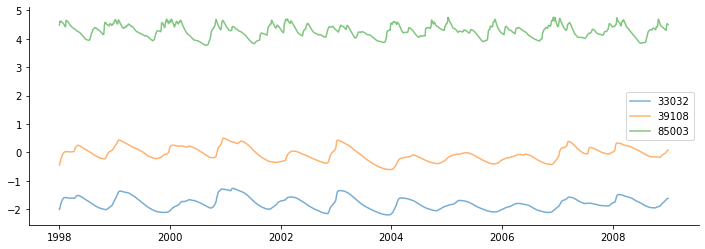

In [44]:
f, ax = plt.subplots(figsize=(12, 4))
for sid in data.station_id.values:
    ax.plot(data["time"], data["obs"].sel(station_id=sid), alpha=0.6, label=sid)
ax.legend()
sns.despine()

In [45]:
filepath = data_dir / "camels_basin_ERA5Land_sm.nc"
raw_era5_ds = xr.open_dataset(filepath)
raw_era5_ds["station_id"] = raw_era5_ds["station_id"].astype(int)
raw = raw_era5_ds

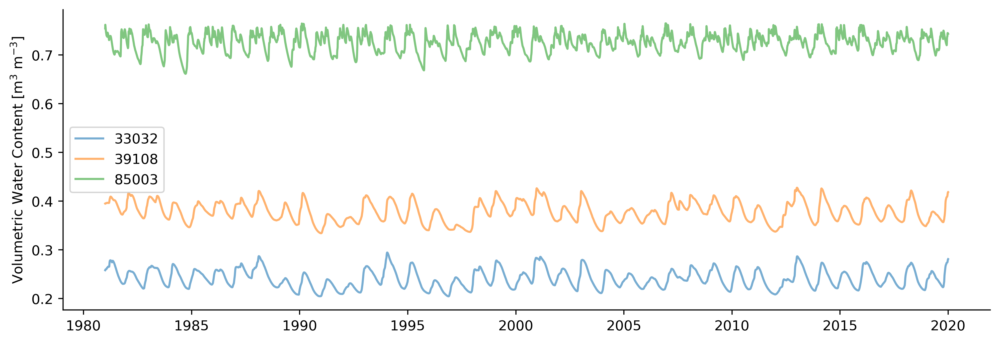

In [46]:
data = raw.drop("spatial_ref").sel(station_id=pixels)

with plt.rc_context({"figure.dpi": 400}):
    f, ax = plt.subplots(figsize=(12, 4))
    for sid in data.station_id.values:
        ax.plot(data["time"], data[target_var].sel(station_id=sid), alpha=0.6, label=sid)

    ax.set_ylabel("Volumetric Water Content [m$^3$ m$^{-3}$]")
    ax.legend()
    sns.despine()

In [47]:
q = 0.01
hi = station_medians.where(station_medians > station_medians.quantile(q=1-q), drop=True).station_id.values
lo = station_medians.where(station_medians < station_medians.quantile(q=q), drop=True).station_id.values
pixels = np.concatenate([hi, lo])
pixels

array([ 80004,  85003,  89002,  89005,  89007,  92001,  12009,  33032,
        33054,  34004,  34011,  34012, 101002])

In [48]:
train_cs

<xarray.Dataset>
Dimensions:     (station_id: 669, time: 3653)
Coordinates:
  * time        (time) datetime64[ns] 1988-01-01 1988-01-02 ... 1997-12-31
  * station_id  (station_id) int64 10002 10003 1001 101002 ... 96002 96004 97002
Data variables: (12/64)
    dim0        (time, station_id) float32 -0.1146 -0.1323 ... 2.099 0.6825
    dim1        (time, station_id) float32 0.02825 0.0172 ... 0.1636 -0.07016
    dim2        (time, station_id) float32 -0.26 -0.3541 ... -3.608 -1.195
    dim3        (time, station_id) float32 -0.1647 -0.0869 ... 0.4397 0.2955
    dim4        (time, station_id) float32 -0.6755 -0.6155 ... -0.1899 -0.2927
    dim5        (time, station_id) float32 0.07694 0.07574 ... 0.07708 0.02484
    ...          ...
    dim58       (time, station_id) float32 0.09641 0.2459 ... -3.909 -4.532
    dim59       (time, station_id) float32 0.2862 0.3911 ... 0.007892 -0.1441
    dim60       (time, station_id) float32 -0.1663 -0.148 ... -1.095 0.1339
    dim61       (time, station_id) float32 -0.01536 -0.001877 ... -0.007871
    dim62       (time, station_id) float32 0.3927 0.366 ... -1.211 -0.3459
    dim63       (time, station_id) float32 0.3793 0.3667 ... 0.3677 0.05346

# Get the context of those pixels

In [49]:
# pixels = [int(min_station), int(med_station), int(max_station)]
pixels = [33032, 39108, 85003, 27087, 54018, 15021]

static["gauge_name"].sel(station_id=pixels)

<xarray.DataArray 'gauge_name' (station_id: 6)>
array([array('Heacham at Heacham', dtype=object),
       array("Churn at Perrott's Brook", dtype=object),
       array('Falloch at Glen Falloch', dtype=object),
       array('Derwent at Low Marishes', dtype=object),
       array('Rea Brook at Hookagate', dtype=object),
       array('Lunan Burn at Mill Bank', dtype=object)], dtype=object)
Coordinates:
  * station_id  (station_id) int64 33032 39108 85003 27087 54018 15021

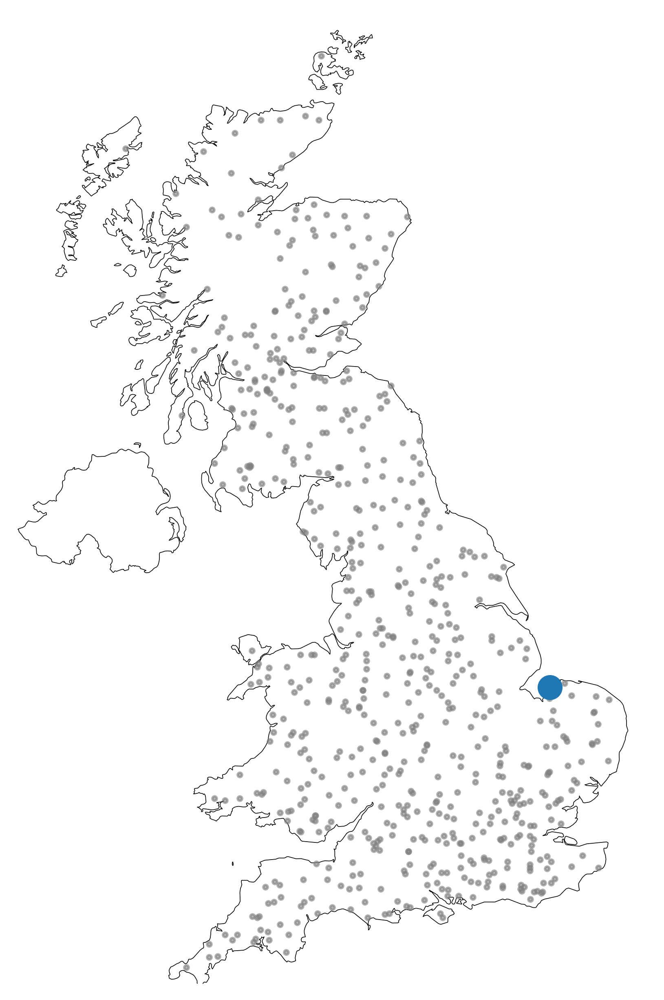

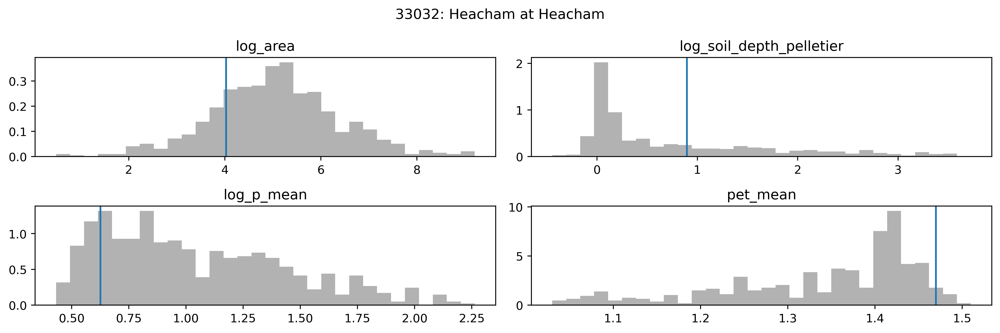

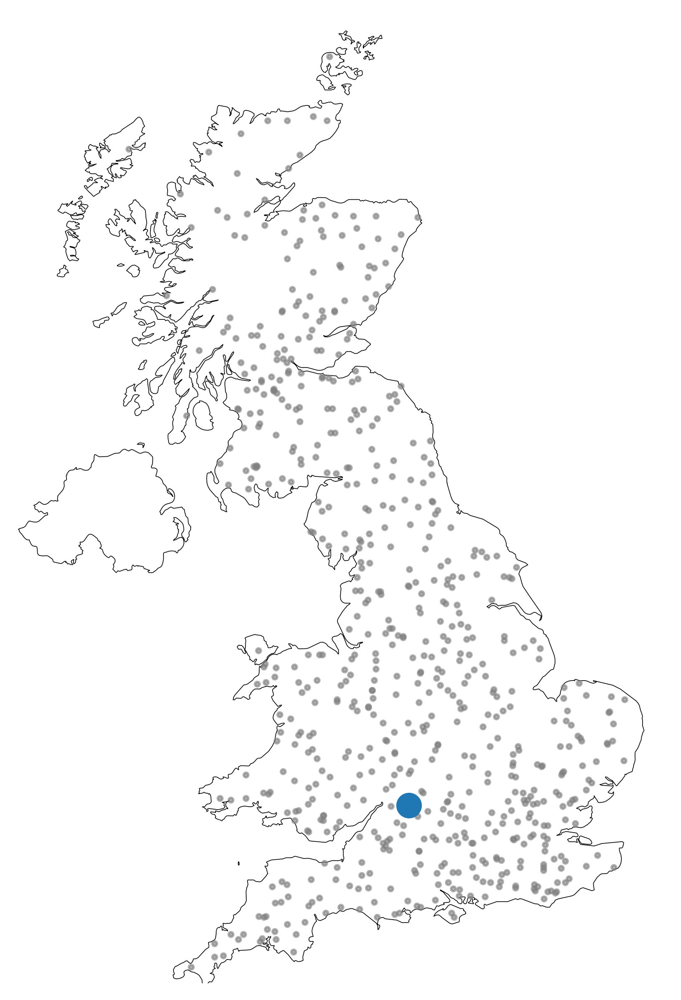

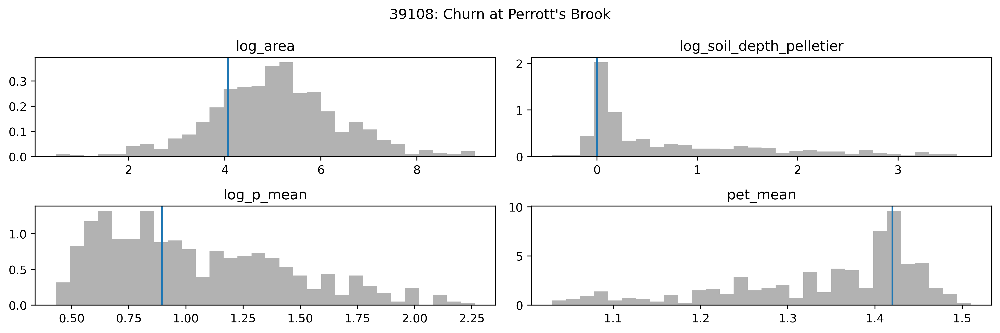

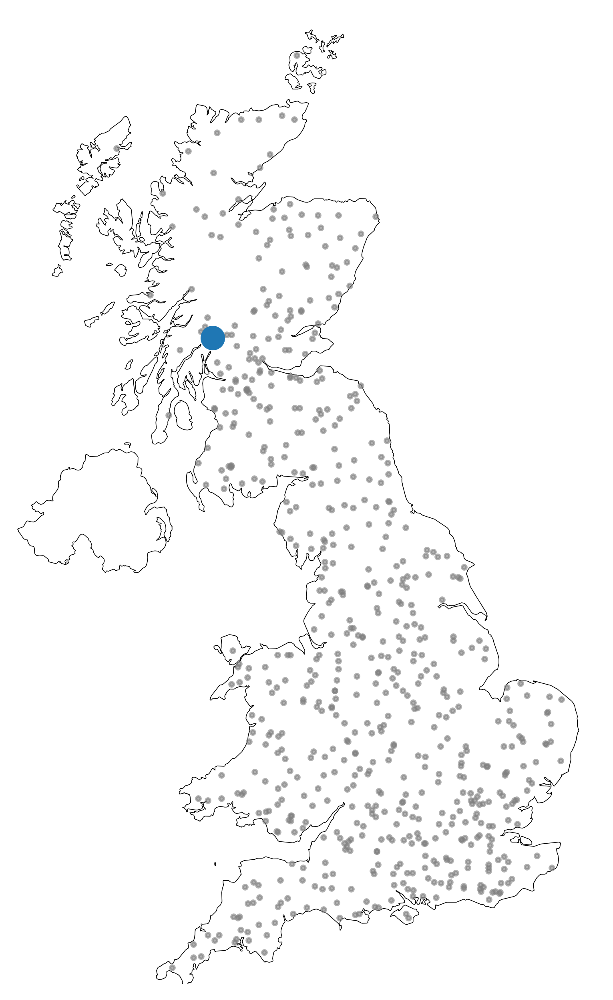

...

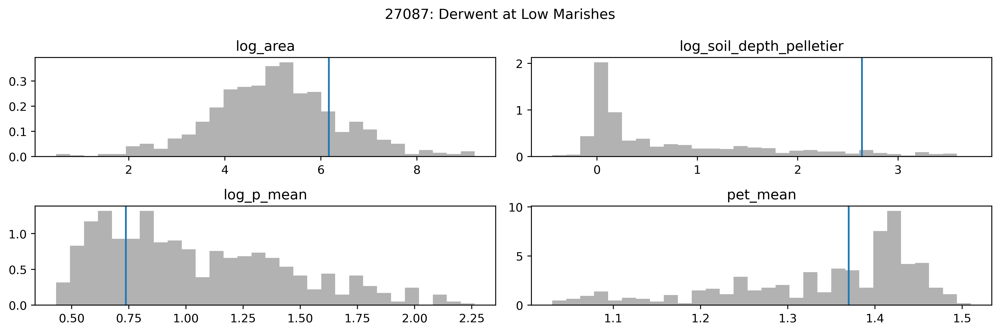

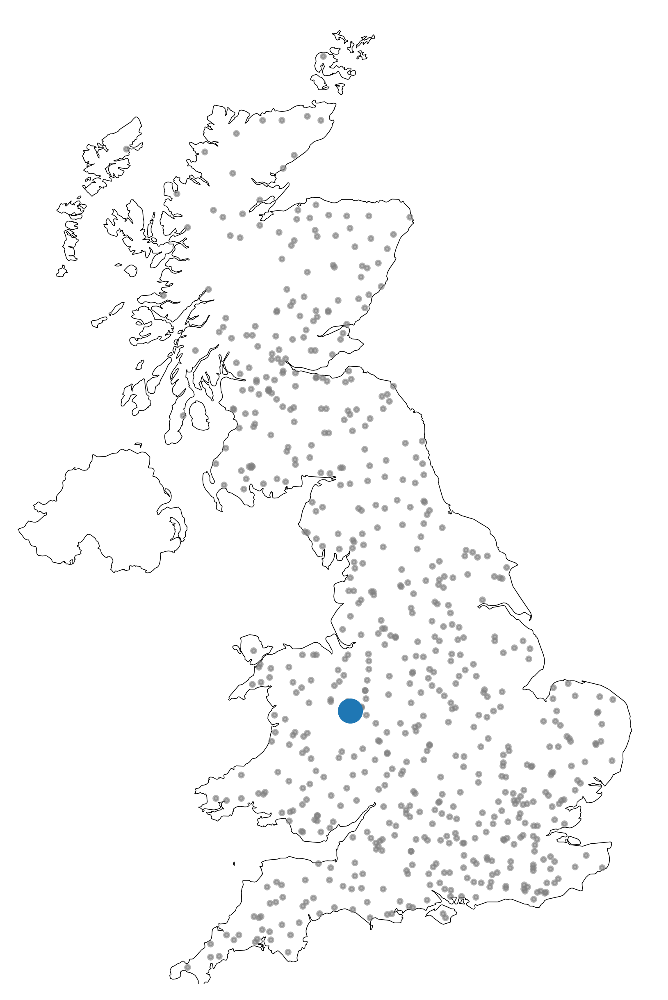

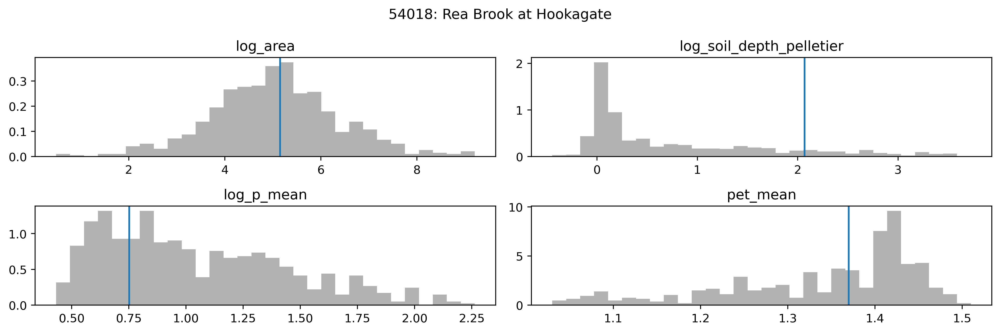

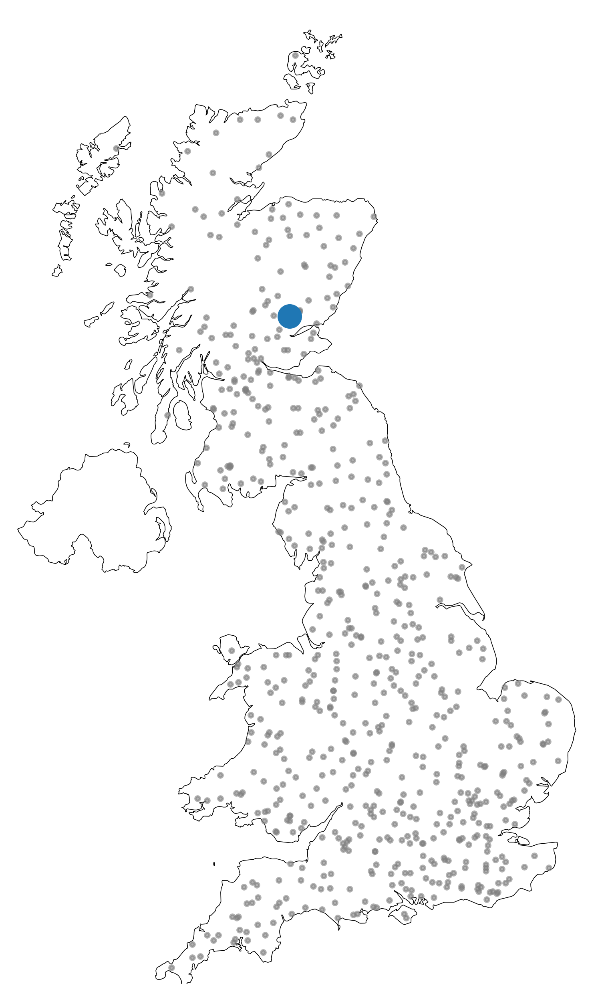

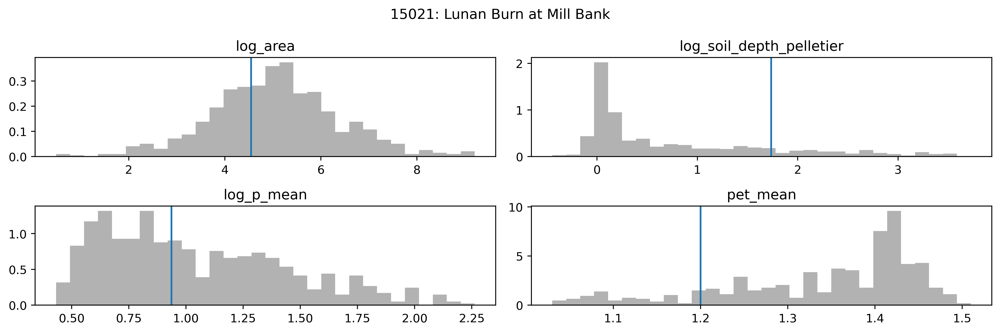

In [50]:
from scripts.geospatial import plot_spatial_location
from scripts.plots import plot_context

log_static = static.copy()
log_static["log_area"] = np.log(static["area"])
log_static["log_p_mean"] = np.log(static["p_mean"])
log_static["log_gauge_elev"] = np.log(static["gauge_elev"])
log_static["log_soil_depth_pelletier"] = np.log(static["soil_depth_pelletier"])
vars_= ["log_area", "log_soil_depth_pelletier", "log_p_mean", "pet_mean"]

with plt.rc_context({"figure.dpi": 400}):
    for px in pixels:
        # plot spatial location
        plot_spatial_location(points=points, sids=[px])
        # plot relative differences
        plot_context(log_static, variables=vars_, sids=[px]);
        plt.gcf().suptitle(f"{px}: {log_static['gauge_name'].sel(station_id=px).values}")


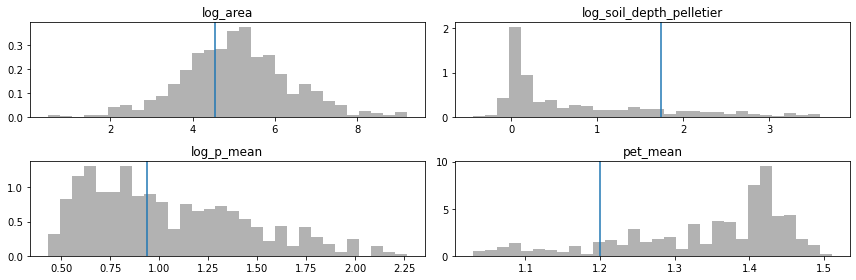

In [51]:
[v for v in static.data_vars if "soil" in v]

static["soil_depth_pelletier"].sel(station_id=15021)

plot_context(log_static, variables=vars_, sids=[px]);

# Non Linear Probe

In [79]:
filepath = data_dir / "era5_nl_models_preds.pkl"

if not (filepath).exists() or not RELOAD:
    if not "nl_models_preds" in globals().keys():
        nl_models_preds = train_and_evaluate_models(all_train_test, hidden_sizes=[20, 10])
    with filepath.open("wb") as f:
        pickle.dump(nl_models_preds, f)
else:
    nl_models_preds = pickle.load(filepath.open("rb"))

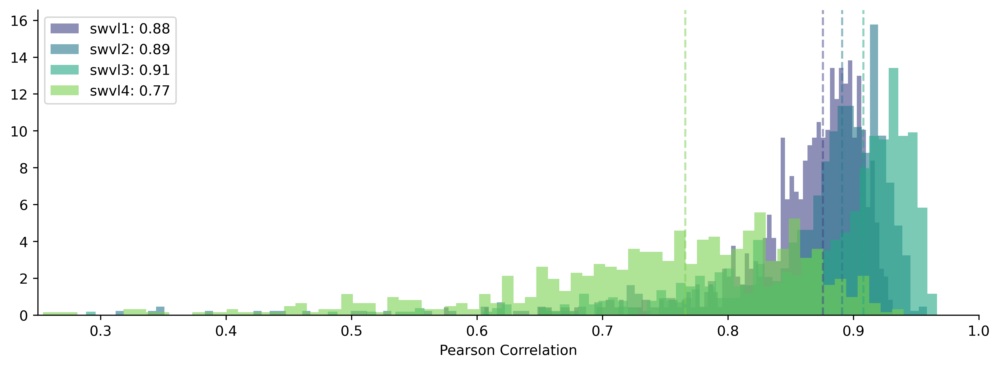

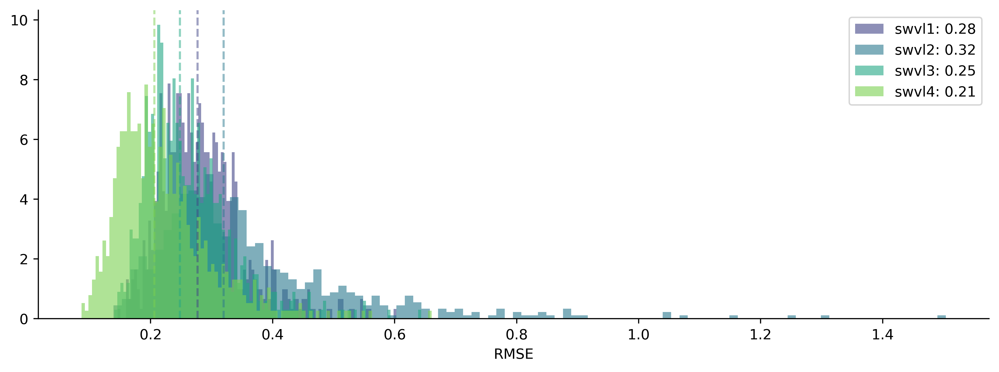

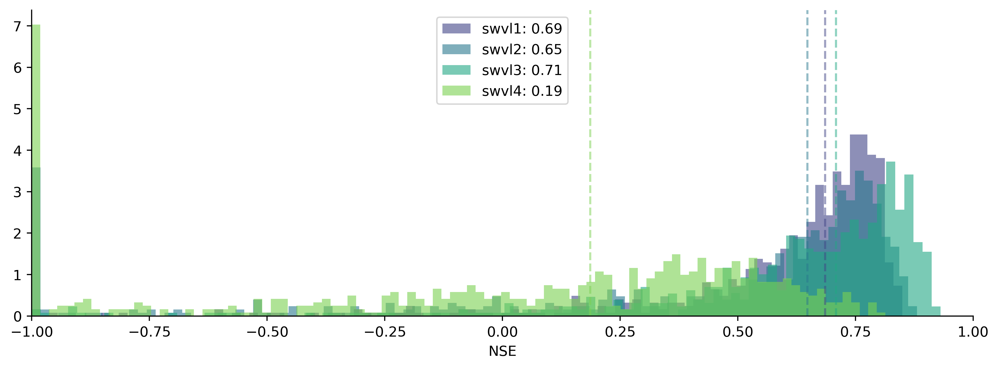

In [54]:
for metric in ["Pearson-r", "RMSE", "NSE"]:

    with plt.rc_context({'figure.dpi': 400}):
        f, ax = plt.subplots(figsize=(12, 4))

        #  metric = "Pearson-r"
        colors = sns.color_palette("viridis", n_colors=len(target_vars))
        for ix, target_var in enumerate(target_vars):
            errors = nl_models_preds[target_var]["errors"]
            nse = errors[metric]

            ax.hist(nse.where(nse > -1, -1), bins=100, density=True, label=f"{target_var}: {nse.median().values:.2f}", alpha=0.6, color=colors[ix]);
            ax.axvline(nse.median(), color=colors[ix], ls="--", alpha=0.5)
        ax.set_xlabel(metric if metric != "Pearson-r" else "Pearson Correlation")
        ax.set_xlim(0.25, 1) if metric in ["Pearson-r"] else None
        ax.set_xlim(-1, 1) if metric in ["NSE"] else None
        ax.legend()
        sns.despine()

NON LINEAR MODEL


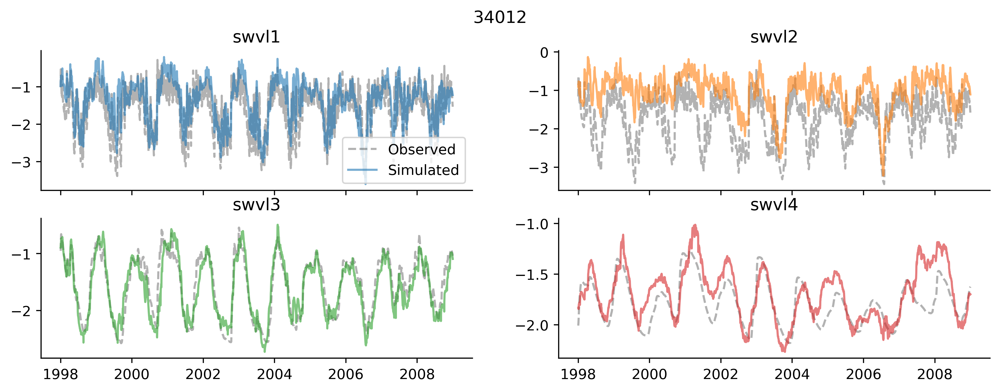

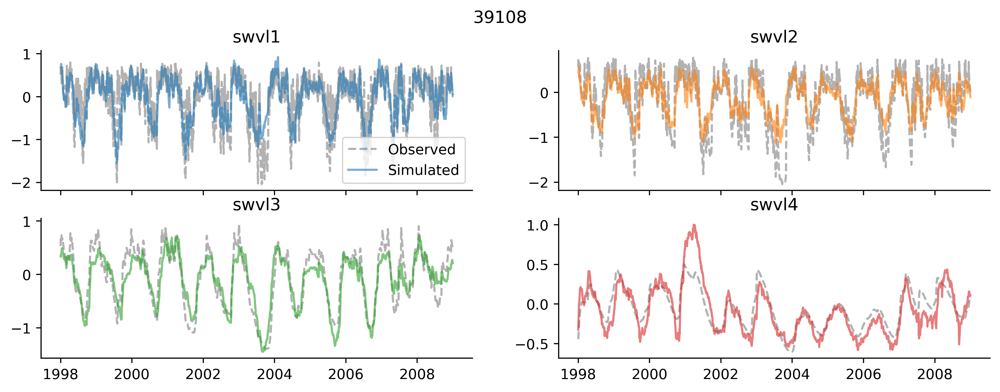

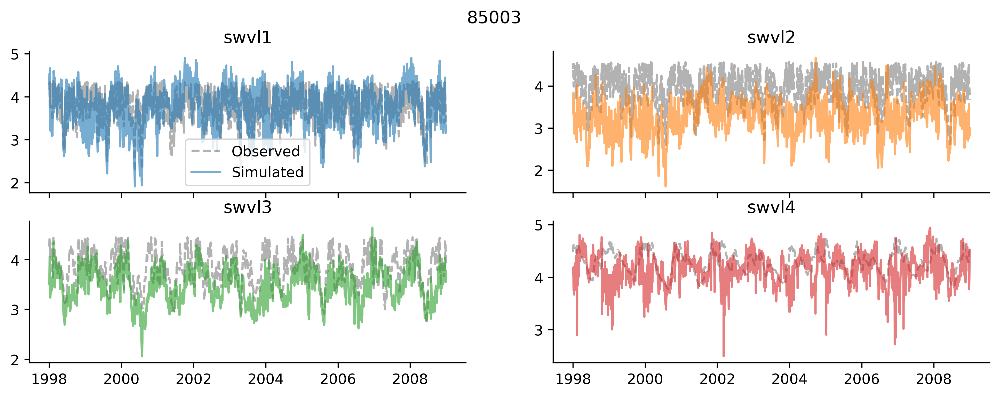

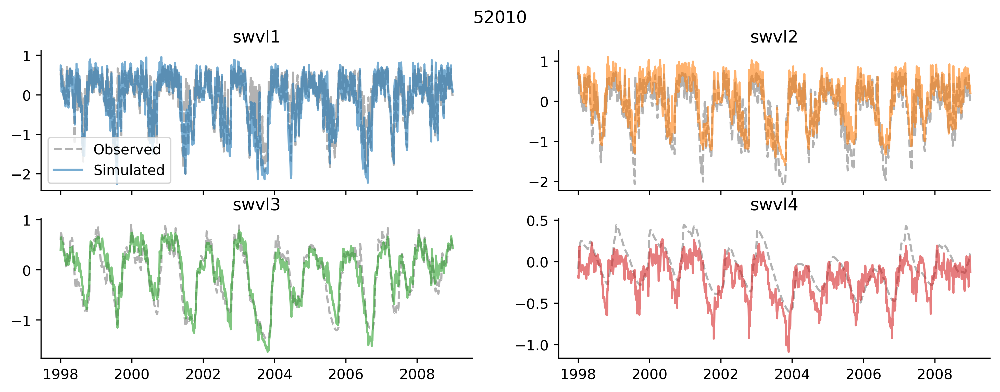

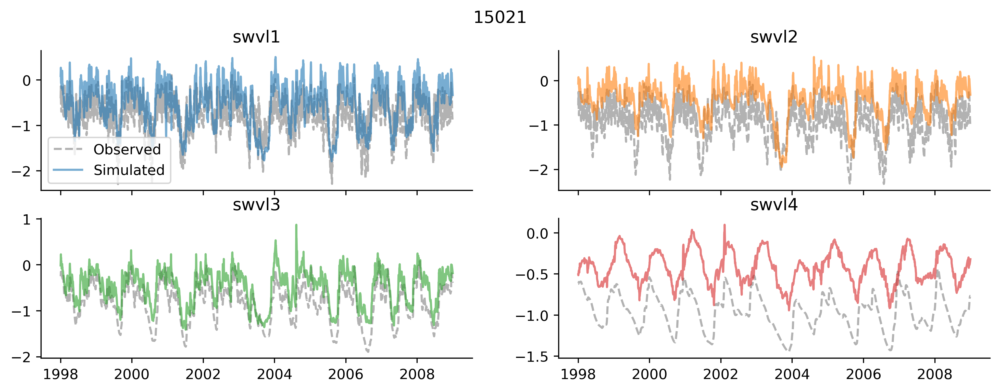

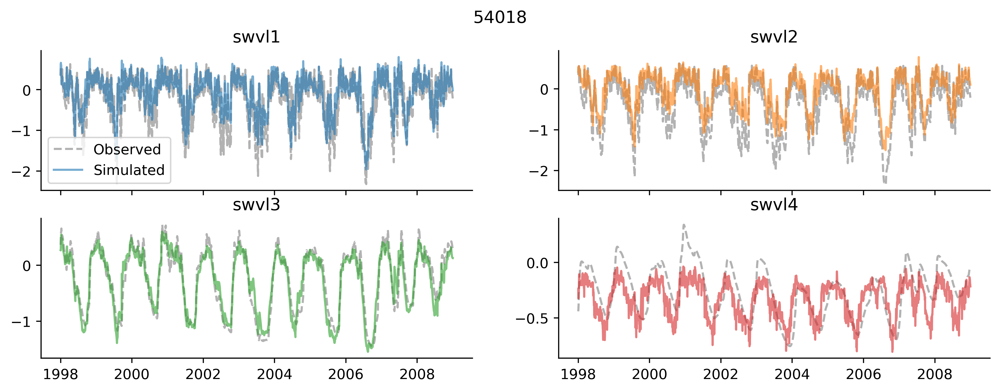

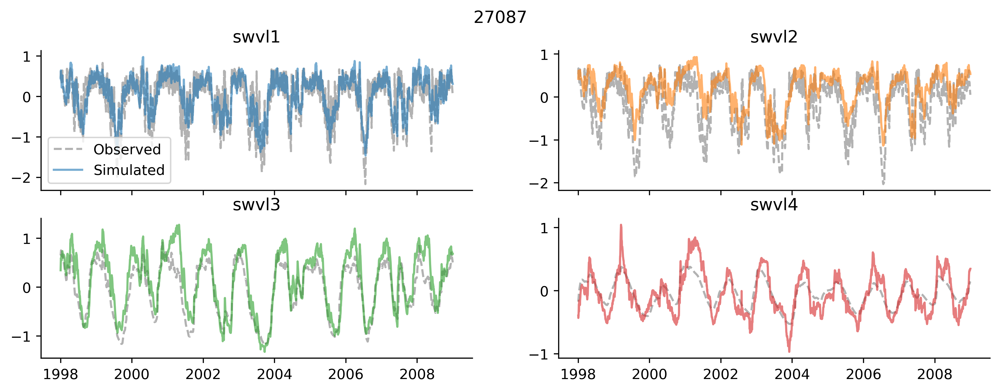

In [55]:
p = all_models_preds["swvl1"]["preds"]
time = slice("2000", "2007")
time = slice("1998", "2008")

N = 3
# pixels = [27030, 38012, 39017]
# pixels = [61001, 14001, 95001]
# pixels = [34012, 52010, 85003]
pixels = [54018, 15021, 48003]
# pixels = [33032, 39108, 85003]
# pixels = [int(min_station), int(med_station), int(max_station)]
pixels = [54018, 15021, 48003, 33032, 39108, 85003]
pixels = [34012, 39108, 85003, 52010, 15021, 54018, 27087]

target_vars = [f"swvl{ix+1}" for ix in range(4)]

with plt.rc_context({"figure.dpi": 400}):
    for px in pixels:
        f, axs = plt.subplots(2, 2, figsize=(12, 4), sharex=True)
        for ix, target_var in enumerate(target_vars):
            ax = axs[np.unravel_index(ix, (2, 2))]
            preds = nl_models_preds[target_var]["preds"]
            data = preds.sel(station_id=px, time=time)

        #     f, ax = plt.subplots(figsize=(12, 4))
            ax.plot(data.time, data.obs, color="k", ls="--", alpha=0.3, label="Observed")
#             ax = ax.twinx()
            ax.plot(data.time, data.sim, color=f"C{ix}", ls="-", alpha=0.6, label="Simulated")
            ax.set_title(f"{target_var}")
            if ix == 0:
                ax.legend()
            sns.despine()
        f.suptitle(px)
        
print("NON LINEAR MODEL")

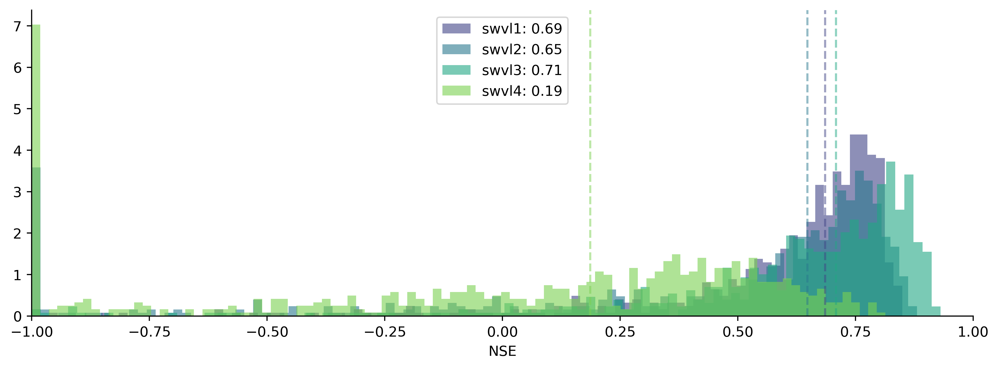

In [56]:
with plt.rc_context({'figure.dpi': 400}):
    f, ax = plt.subplots(figsize=(12, 4))

    metric = "NSE"
    colors = sns.color_palette("viridis", n_colors=len(target_vars))
    for ix, target_var in enumerate(target_vars):
        errors = nl_models_preds[target_var]["errors"]
        nse = errors[metric]

        ax.hist(nse.where(nse > -1, -1), bins=100, density=True, label=f"{target_var}: {nse.median().values:.2f}", alpha=0.6, color=colors[ix]);
        ax.axvline(nse.median(), color=colors[ix], ls="--", alpha=0.5)
    ax.set_xlabel(metric if metric != "Pearson-r" else "Pearson Correlation")
    ax.set_xlim(-1, 1)
    ax.legend()
    sns.despine()

# intercomparison of NL Probe vs. Lin Probe

In [57]:
lin = all_models_preds["swvl1"]["preds"]
nlin = nl_models_preds["swvl1"]["preds"]

In [58]:
sid = 54018

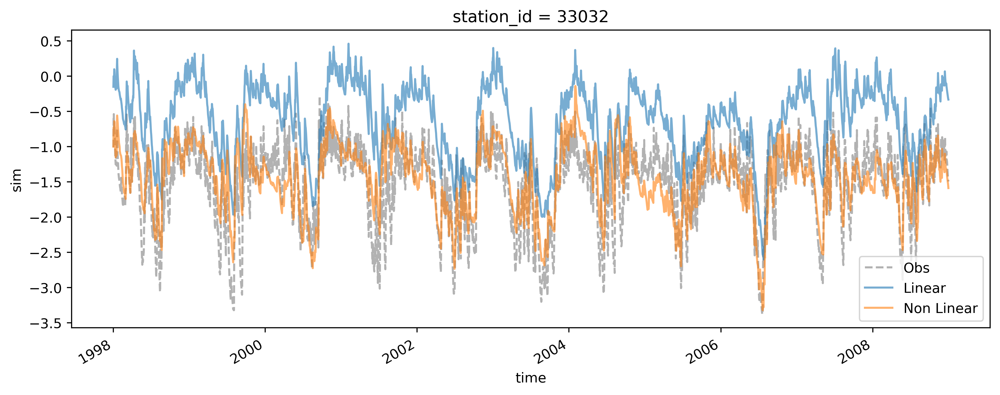

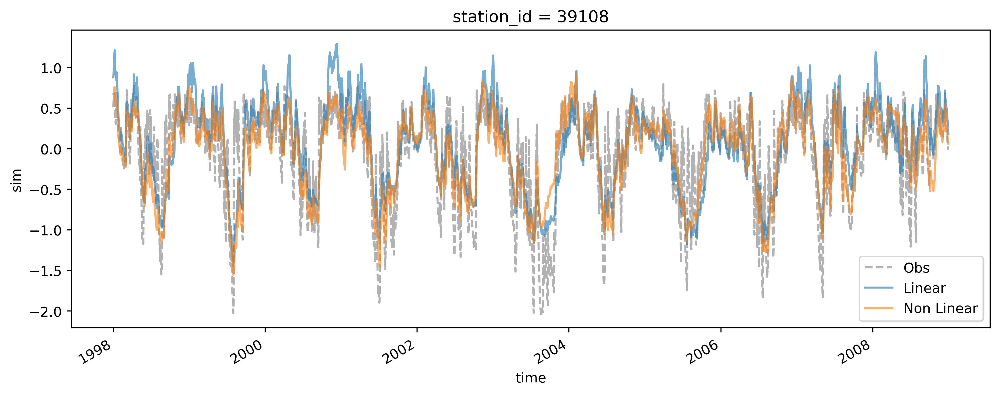

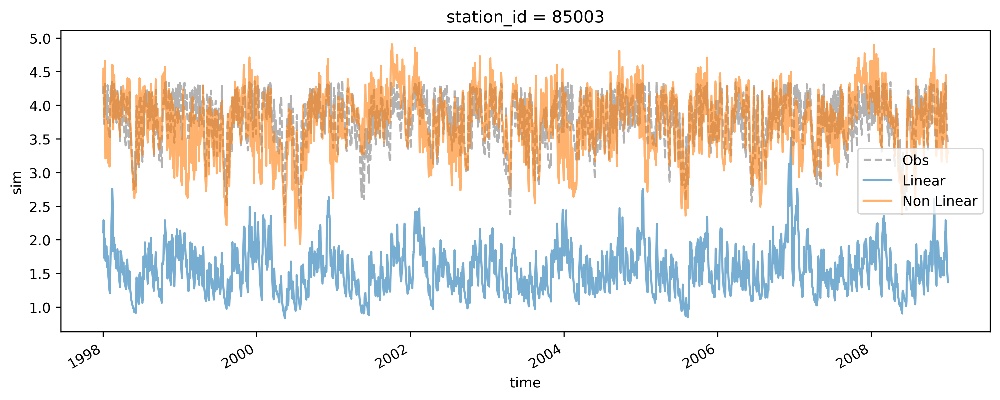

In [59]:
sids = [33032, 39108, 85003]

with plt.rc_context({"figure.dpi": 400}):
    for sid in sids:
        f, ax = plt.subplots(figsize=(12, 4))
        lin.sel(station_id=sid)["obs"].plot(label="Obs", ax=ax, alpha=0.3, ls="--", color="k")
        lin.sel(station_id=sid)["sim"].plot(label="Linear", ax=ax, alpha=0.6)
        nlin.sel(station_id=sid)["sim"].plot(label="Non Linear", ax=ax, alpha=0.6)
        plt.legend()

# Explore the ERA5 data

In [60]:
import xarray as xr 
from pathlib import Path
import matplotlib.pyplot as plt 
import numpy as np 

data_dir = Path("/datadrive/data")
era = xr.open_dataset(data_dir / "gb_soil_moisture_1234_snow.nc")
mean_era = era.mean(dim="time")

In [61]:
mask = mean_era["swvl1"].isnull()
mean_era = mean_era.where(~mask)

<ipython-input-62-169cdfea6416>:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([""])
<ipython-input-62-169cdfea6416>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([""])


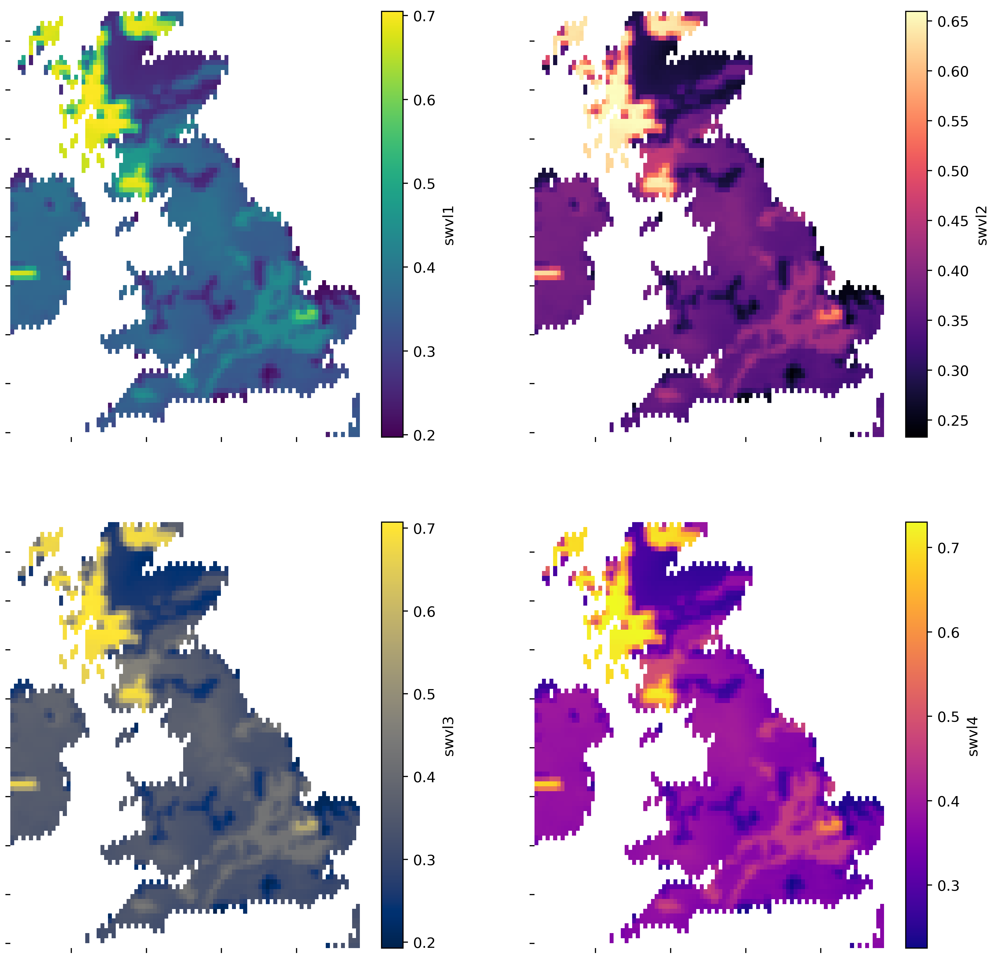

In [62]:
with plt.rc_context({'figure.dpi': 400}):

    f, axs = plt.subplots(2, 2, figsize=(12, 12))

    target_vars = [f"swvl{ix+1}" for ix in range(4)]
    palettes = ["viridis", "magma", "cividis", "plasma"]
    for ix, var_ in enumerate(target_vars):
        ax = axs[np.unravel_index(ix, (2, 2))]
        
        mean_era[var_].plot(ax=ax, cmap=palettes[ix])
        ax.set_xlabel("")
        ax.set_ylabel("")
        ax.set_xticklabels([""])
        ax.set_yticklabels([""])

        for spine in ["top", "left", "right", "bottom"]:
            ax.spines[spine].set_visible(False)


# What about the spatial performances?

In [63]:
import geopandas as gpd
from scripts.geospatial import initialise_gb_spatial_plot, load_latlon_points
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [64]:
points = load_latlon_points(data_dir)

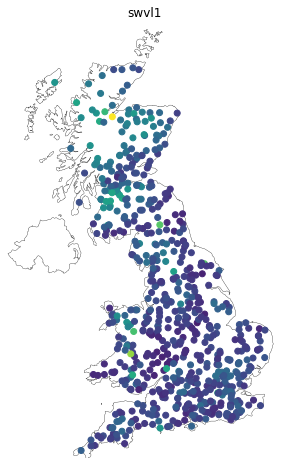

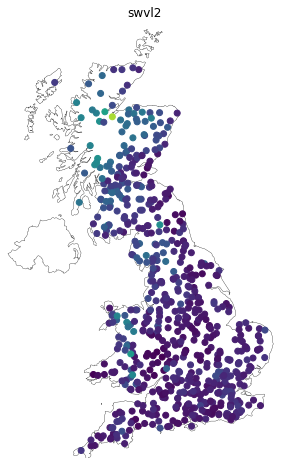

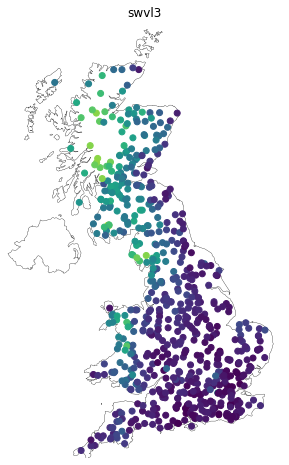

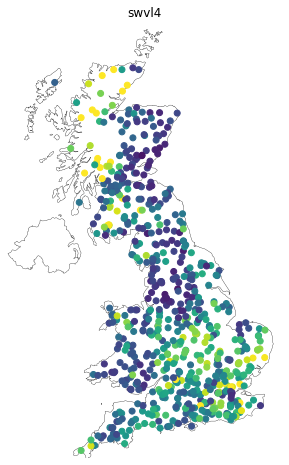

In [65]:
metric = "Pearson-r"
for target_var in target_vars:
    # initialise plotting data
    errors = all_models_preds[target_var]["errors"]
    gdf = gpd.GeoDataFrame(errors[metric].to_dataframe().join(points))
    
    # create plot
    ax = initialise_gb_spatial_plot()

    cbar = False
    vmax = 0.95
    vmin = 0.5

    if cbar:
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        gdf.plot(metric, ax=ax, vmin=vmin, vmax=vmax, cmap="viridis_r", cax=cax, legend=True);
    else:
        gdf.plot(metric, ax=ax, vmin=vmin, vmax=vmax, cmap="viridis_r")
    
    ax.set_title(f"{target_var}")

# Visualising individual dimensions

In [66]:
def get_ws_bs_for_target_var(all_models_preds, target_var: str):
    model = all_models_preds[target_var]["model"]
    w, b = get_model_weights(model)
    return w, b


target_var = "swvl1"
w, b = get_ws_bs_for_target_var(all_models_preds, target_var)


max_idx = np.argmax(np.abs(w))
n = 3
largest_n = np.abs(w).argsort()[-n:][::-1]
feature = f"dim{max_idx}"

# get largest n weights
largest_n_ws = w[largest_n]

features = [f"dim{idx}" for idx in largest_n]
assert all(np.isin(features, test_cs.data_vars)), f"Expect {features} to be in cs.data_vars"

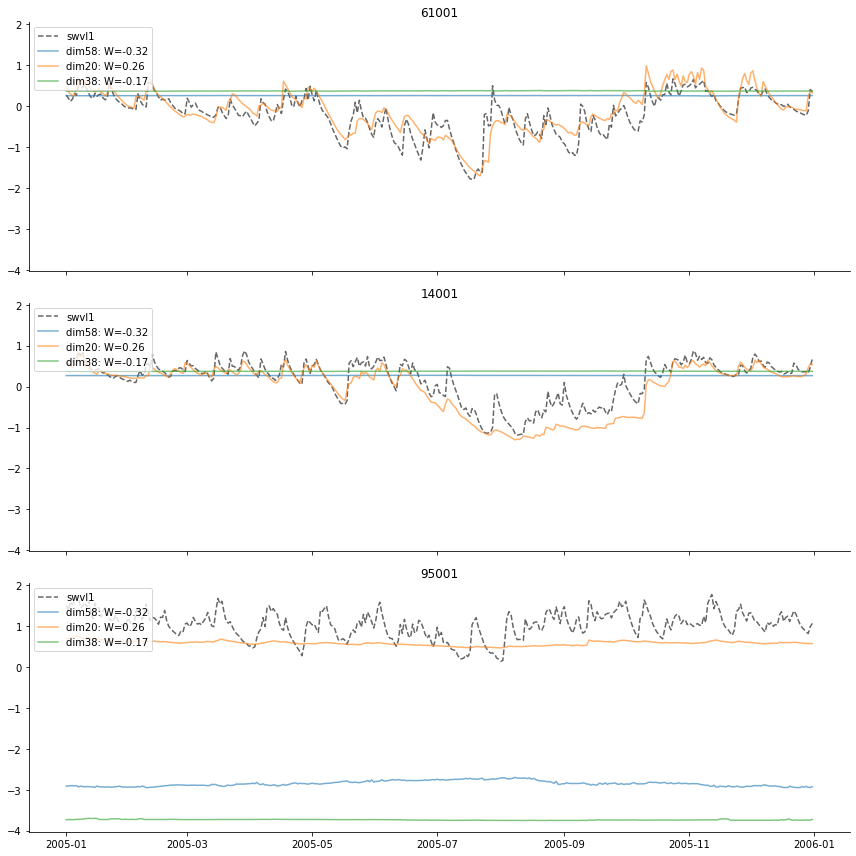

In [67]:
time = "2005"

px = 53013
pxs = [px]

Npxs = 2
pxs = np.random.choice(test_cs.station_id.values, Npxs)

pxs = [61001, 14001, 95001]
f, axs = plt.subplots(len(pxs), 1, figsize=(12, 4*len(pxs)), tight_layout=True, sharex=True, sharey=True)
for ix, px in enumerate(pxs):
    ax = axs[ix]
    data = test_cs.sel(station_id=px, time=time).to_dataframe()
    target = era5_ds.sel(station_id=px, time=time).to_dataframe()

    ax.plot(target.index, target[target_var], label=target_var, color="k", ls="--", alpha=0.6)
    ax.legend(loc="upper right")

#     ax = ax.twinx()
    for ix, feature in enumerate(features):  # features  ["dim20"]  ["dim58"]
        ax.plot(
            data.index, data[feature], label=f"{feature}: W={largest_n_ws[ix]:.2f}", color=f"C{ix}", alpha=0.6
        )
        ax.legend(loc="upper left")
    
    ax.set_title(px)
    sns.despine()

# explore single dimensions

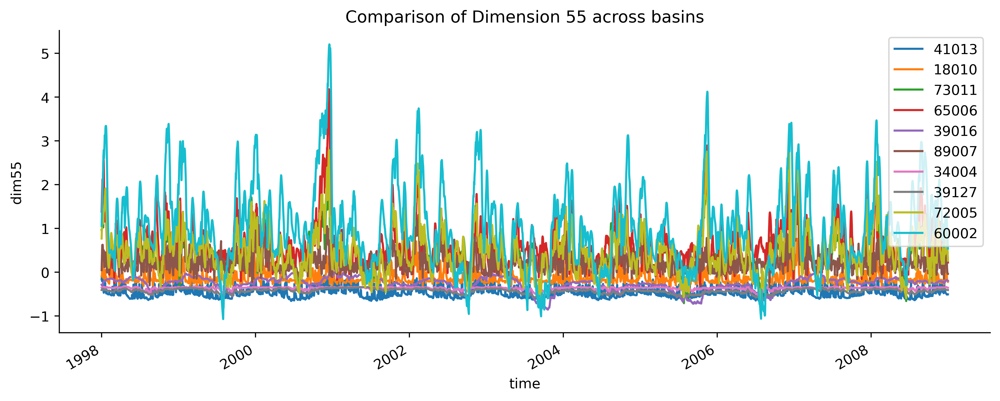

In [68]:
DIM = 55

with plt.rc_context({"figure.dpi": 400}):
    f, ax = plt.subplots(figsize=(12, 4))

    pxs = np.random.choice(test_cs.station_id.values, 10)
    for sid in pxs:
        test_cs[f"dim{DIM}"].sel(station_id=sid).plot(ax=ax, label=sid)
    ax.legend()
    ax.set_title(f"Comparison of Dimension {DIM} across basins")
    sns.despine()

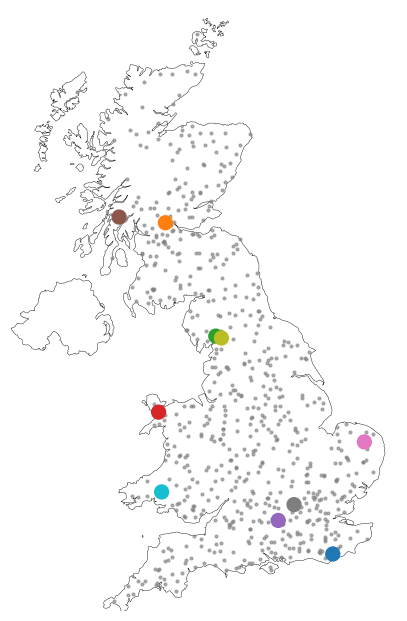

In [69]:
from scripts.geospatial import plot_spatial_location
with plt.rc_context({"figure.dpi": 100}):
    plot_spatial_location(pxs, points=points, plot_kwargs={"color": [f"C{ix}" for ix in np.arange(len(pxs))]})

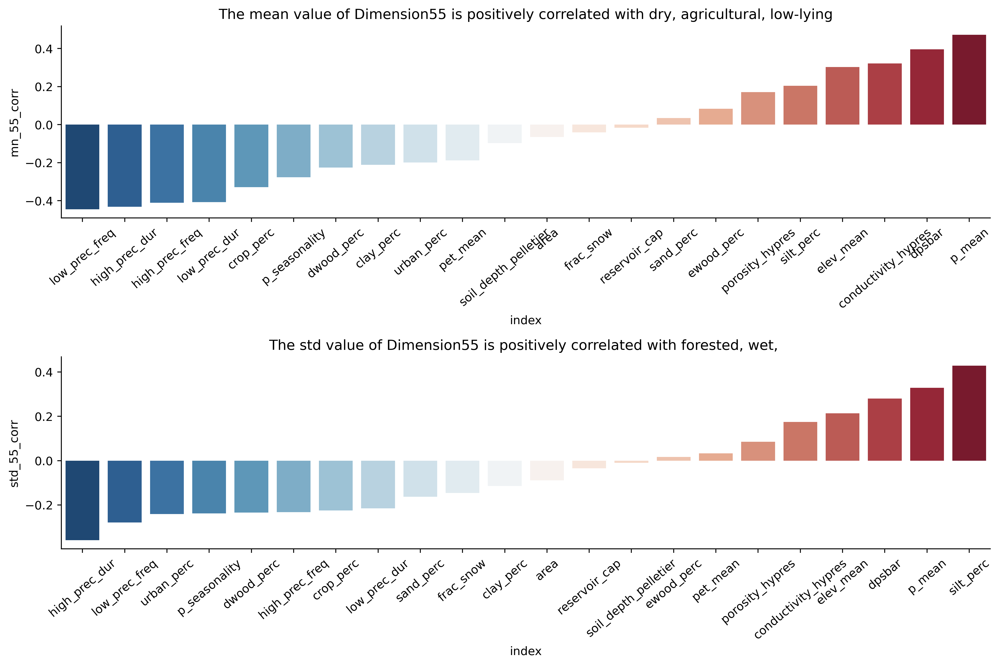

In [70]:
var_31 = test_cs[f"dim{DIM}"].std(dim="time")
mn_31 = test_cs[f"dim{DIM}"].mean(dim="time")

df = (
    static[cfg.static_attributes].to_dataframe()
    .join(var_31.rename(f"std_{DIM}").to_dataframe())
    .join(mn_31.rename(f"mn_{DIM}").to_dataframe())
)

# correlations ?
corrs = pd.DataFrame({v: df[f"mn_{DIM}"].corr(df[v]) for v in df.columns if v not in [f'std_{DIM}', f'mn_{DIM}']}, index=[f"mn_{DIM}_corr"]).T.reset_index()
# var = f"std_{DIM}"
corrs = (
    pd.DataFrame(
        {v: df[f"std_{DIM}"].corr(df[v]) for v in df.columns if v not in [f'std_{DIM}', f'mn_{DIM}']}, 
        index=[f"std_{DIM}_corr"]
    ).T.reset_index()
    .join(corrs.drop("index", axis=1))
)

with plt.rc_context({"figure.dpi": 400}):
    f, axs = plt.subplots(2,1,figsize=(12, 4*2), tight_layout=True)
    
    ax = axs[0]
    sns.barplot(x="index", y=f"mn_{DIM}_corr", data=corrs.sort_values(f"mn_{DIM}_corr"), palette="RdBu_r", ax=ax)
    ax.set_title(f"The mean value of Dimension{DIM} is positively correlated with dry, agricultural, low-lying")
    plt.xticks(rotation=40)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=40)
    
    ax = axs[1]
    sns.barplot(x="index", y=f"std_{DIM}_corr", data=corrs.sort_values(f"std_{DIM}_corr"), palette="RdBu_r", ax=ax)
    ax.set_title(f"The std value of Dimension{DIM} is positively correlated with forested, wet, ")
    
    plt.xticks(rotation=40)
        
    sns.despine()

Text(0.5, 1.0, 'STD Dimension55')

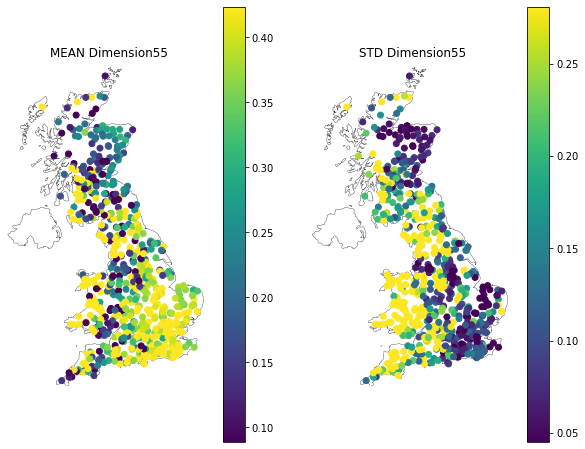

In [71]:
gdf_31 = gpd.GeoDataFrame(test_cs[f"dim{DIM}"].median(dim="time").to_dataframe().join(points))
gdf_31 = gdf_31.join(test_cs[f"dim{DIM}"].std(dim="time").rename(f"std_dim{DIM}").to_dataframe())
gdf_31[f"abs_dim{DIM}"] = abs(gdf_31[f"dim{DIM}"])
# gdf_31[f"abs_std_dim{DIM}"] = gdf_31[f"std_dim{DIM}"]

f, axs = plt.subplots(1, 2, figsize=(5*2, 8))
ax = axs[0]
mn_vmin, mn_vmax = gdf_31[f"abs_dim{DIM}"].quantile(q=0.1), gdf_31[f"abs_dim{DIM}"].quantile(q=0.7)
initialise_gb_spatial_plot(ax=ax)
gdf_31.plot(f"abs_dim{DIM}", legend=True, ax=ax, vmin=mn_vmin, vmax=mn_vmax)
ax.set_title(f"MEAN Dimension{DIM}")

ax = axs[1]
std_vmin, std_vmax = gdf_31[f"std_dim{DIM}"].quantile(q=0.1), gdf_31[f"std_dim{DIM}"].quantile(q=0.7)
initialise_gb_spatial_plot(ax=ax)
gdf_31.plot(f"std_dim{DIM}", legend=True, ax=ax, vmin=std_vmin, vmax=std_vmax)
ax.set_title(f"STD Dimension{DIM}")

# Generating spatial maps of Soil Moisture

In [72]:
from scripts.cell_state.timeseries_model import _round_time_to_hour

gdf = gpd.read_file(data_dir / "CAMELS_GB_DATASET/Catchment_Boundaries/CAMELS_GB_catchment_boundaries.shp")

In [73]:
LEVEL = "swvl1"
preds = all_models_preds[LEVEL]["preds"]
preds = nl_models_preds[LEVEL]["preds"]
preds["time"] = _round_time_to_hour(preds["time"].values)

In [74]:
d = preds["sim"]

# pivot table simulations
pixel_dim = "station_id"
time_dim = "time"
new_ds = xr.Dataset(
    {
        f"{i}": ((pixel_dim), d.values[:, i])
        for i in range(len(d[time_dim].values))
    },
    coords={pixel_dim: d[pixel_dim]},
)
df = new_ds.to_dataframe()

In [75]:
time_gdf = gpd.GeoDataFrame(df.join(gdf.set_index("ID")))
mean_std = time_gdf[[f"{ts}" for ts in np.arange(822)]].std().mean()
vmax = time_gdf[[f"{ts}" for ts in np.arange(822)]].mean().max() + (0.1 * mean_std)
vmin = time_gdf[[f"{ts}" for ts in np.arange(822)]].mean().min() - (0.1 * mean_std)

(vmin, vmax)

(-1.252157420322548, 0.7637730208821176)

In [76]:
# https://www.earthdatascience.org/courses/scientists-guide-to-plotting-data-in-python/plot-spatial-data/customize-vector-plots/python-customize-map-legends-geopandas/
# ax = initialise_gb_spatial_plot()
# 
if False:
    (data_dir / f"animate_{LEVEL}").mkdir(exist_ok=True)
    from tqdm import tqdm

    with plt.style.context("dark_background"):
        for i in tqdm(np.arange(822)):
            f, ax = plt.subplots(figsize=(5, 8))
            time_gdf.plot(f"{i}", ax=ax, vmin=vmin, vmax=vmax, legend=True)
            ax.axis("off")
            ax.set_title(np.datetime_as_string(lookup_times[i], unit="D"))
            f.savefig(data_dir / f"animate/{i:03}.png")
            del f, ax
            plt.close("all")

In [77]:
# time_gdf
time_lookup = xr.Dataset(
    {"index": ("time", np.arange(len(preds["time"])))}, 
     coords={"time": preds["time"]}
)
lookup_times = dict(zip(time_lookup["index"].values, time_lookup["time"].values))

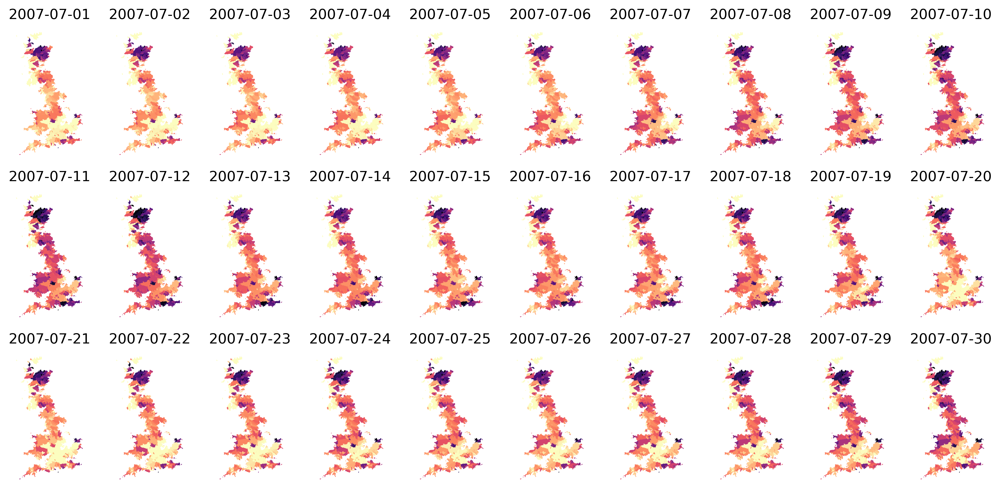

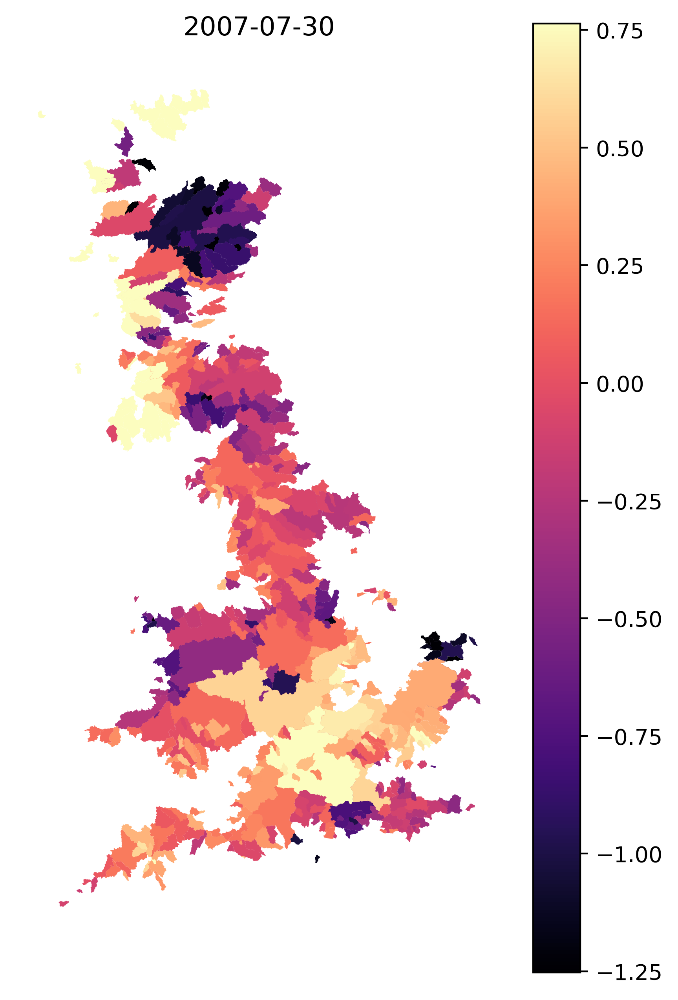

In [80]:
time = "07-2007"
indexes = time_lookup.sel(time=time)["index"].values[:30]

with plt.rc_context({"figure.dpi": 400}):
    f, axs = plt.subplots(3, 10, figsize=(5*0.3*10, 8*0.3*3))
    
    for ix, i in enumerate(indexes):
        ax = axs[np.unravel_index(ix, (3, 10))]
        time_gdf.plot(f"{i}", ax=ax, vmin=vmin, vmax=vmax, legend=False, cmap="magma")
        ax.axis("off")
        ax.set_title(np.datetime_as_string(lookup_times[i], unit="D"))

    f, ax = plt.subplots(figsize=(5, 8))
    ix = ix - 1
    time_gdf.plot(f"{i}", ax=ax, vmin=vmin, vmax=vmax, legend=True, cmap="magma")
    ax.axis("off")
    ax.set_title(np.datetime_as_string(lookup_times[i], unit="D"))


# What about snow?

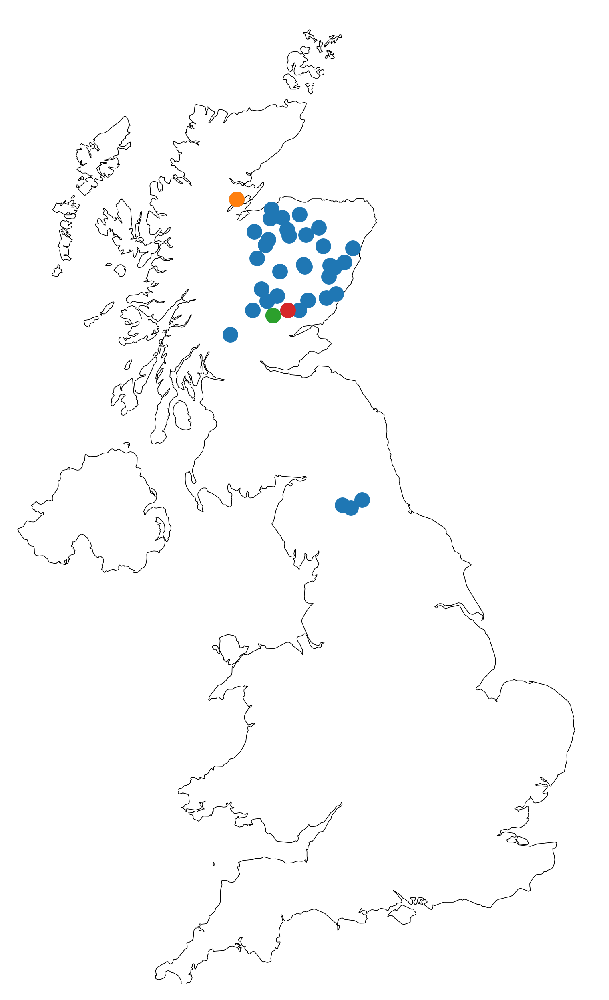

In [81]:
snowy_sids = static.sel(station_id=static["frac_snow"] > 0.05).station_id
gdf = gpd.GeoDataFrame(snowy_sids.to_dataframe().join(points))

with plt.rc_context({"figure.dpi": 400}):
    ax = initialise_gb_spatial_plot()
    gdf.plot(ax=ax);
    gdf.loc[[4003]].plot(ax=ax, color="C1")
    gdf.loc[[15023]].plot(ax=ax, color="C2")
    gdf.loc[[15025]].plot(ax=ax, color="C3")

In [82]:
snow_target_ds = era5_ds[["sd"]]
input_ds = train_cs

In [83]:
snow_train_target_ds = snow_target_ds.sel(station_id=np.isin(target_ds.station_id, snowy_sids), time=np.isin(target_ds.time, train_cs.time))
snow_test_target_ds = snow_target_ds.sel(station_id=np.isin(target_ds.station_id, snowy_sids), time=np.isin(target_ds.time, test_cs.time))

input_variables = list(train_cs.data_vars)
seq_length = 1
basin_dim = "station_id"
time_dim = "time"

In [84]:
from scripts.cell_state.utils import create_train_test_default_dict_for_all_target_vars, TimeSeriesDataset, get_time_basin_aligned_dictionary

snow_train_test = create_train_test_default_dict_for_all_target_vars(
    train_cs=train_cs,
    test_cs=test_cs,
    train_target_ds=snow_train_target_ds,
    test_target_ds=snow_test_target_ds,
    input_variables=input_variables,
)

Creating Train Samples:   0%|          | 0/36 [00:00<?, ?it/s]

** STARTING sd **


Extracting Data:   3%|▎         | 15/565 [00:00<00:03, 144.33it/s]

Merging and reshaping arrays


Extracting Data: 100%|██████████| 565/565 [00:03<00:00, 145.13it/s]

Merging and reshaping arrays


In [85]:
snow_models_preds = train_and_evaluate_models(snow_train_test, sgd=True)

** sd linear model **
-- Epoch 1
Norm: 0.70, NNZs: 25, Bias: -0.009596, T: 118324, Avg. loss: 0.054438
Total training time: 0.08 seconds.
-- Epoch 2
Norm: 0.74, NNZs: 24, Bias: -0.012057, T: 236648, Avg. loss: 0.053814
Total training time: 0.18 seconds.
-- Epoch 3
Norm: 0.75, NNZs: 23, Bias: -0.008489, T: 354972, Avg. loss: 0.053759
Total training time: 0.27 seconds.
-- Epoch 4
Norm: 0.75, NNZs: 22, Bias: -0.009258, T: 473296, Avg. loss: 0.053765
Total training time: 0.37 seconds.
Convergence after 4 epochs took 0.38 seconds


Calculating Errors: 100%|██████████| 36/36 [00:00<00:00, 42.87it/s, 25012]

In [269]:
(run_dir/"snow").mkdir(exist_ok=True)
from scripts.cell_state.analysis import save_probe_components

save_probe_components(run_dir / "snow", snow_models_preds)

Saving data: 100%|██████████| 1/1 [00:00<00:00, 49.61it/s]


In [86]:
if not "nl_snow_models_preds" in globals().keys():
    nl_snow_models_preds = train_and_evaluate_models(snow_train_test, hidden_sizes=[20, 10])

** sd non-linear model **
Iteration 1, loss = 1.99333702
Validation score: 0.778562
Iteration 2, loss = 1.10394506
Validation score: 0.823180
Iteration 3, loss = 0.91451238
Validation score: 0.843827
Iteration 4, loss = 0.82180714
Validation score: 0.857960
Iteration 5, loss = 0.76956587
Validation score: 0.864627
Iteration 6, loss = 0.73260165
Validation score: 0.867880
Iteration 7, loss = 0.70313976
Validation score: 0.875938
Iteration 8, loss = 0.68484246
Validation score: 0.876877
Iteration 9, loss = 0.66942782
Validation score: 0.878407
Iteration 10, loss = 0.65274990
Validation score: 0.881948
Iteration 11, loss = 0.63937580
Validation score: 0.873827
Iteration 12, loss = 0.62783582
Validation score: 0.880010
Iteration 13, loss = 0.61960531
Validation score: 0.887907
Iteration 14, loss = 0.60725394
Validation score: 0.889804
Iteration 15, loss = 0.60275061
Validation score: 0.889903
Iteration 16, loss = 0.59095900
Validation score: 0.893114
Iteration 17, loss = 0.58684403
Validat

Calculating Errors:   0%|          | 0/36 [00:00<?, ?it/s, 7006]

Iteration 27, loss = 0.53250347
Validation score: 0.899860
Validation score did not improve more than tol=0.000100 for 3 consecutive epochs. Stopping.


Calculating Errors: 100%|██████████| 36/36 [00:00<00:00, 42.69it/s, 25012]


In [87]:
snow_models_preds["sd"]["preds"]
# nl_snow_models_preds["sd"]["preds"]

<xarray.Dataset>
Dimensions:     (station_id: 36, time: 4017)
Coordinates:
  * station_id  (station_id) int64 4003 7001 7002 7005 ... 24003 25003 25012
  * time        (time) datetime64[ns] 1998-01-01T00:00:30.215962624 ... 2008-...
Data variables:
    obs         (station_id, time) float32 -0.0139 -0.07014 ... -0.1328 -0.1134
    sim         (station_id, time) float64 -0.08591 -0.1406 ... -0.2361 -0.1765

### plot timeseries

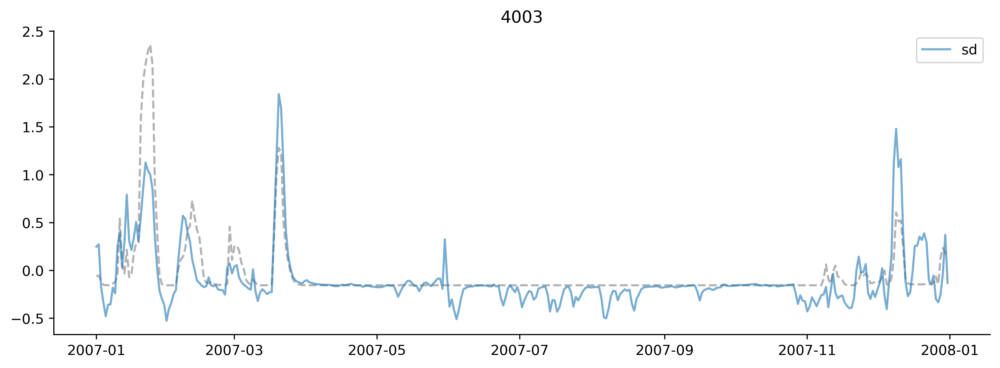

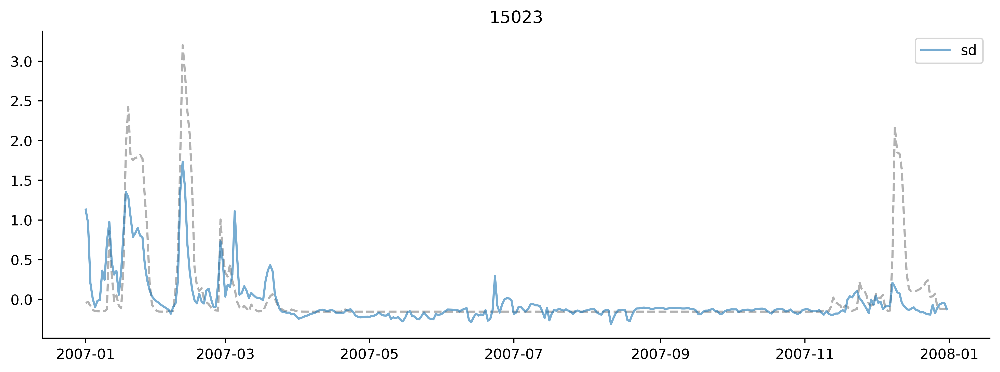

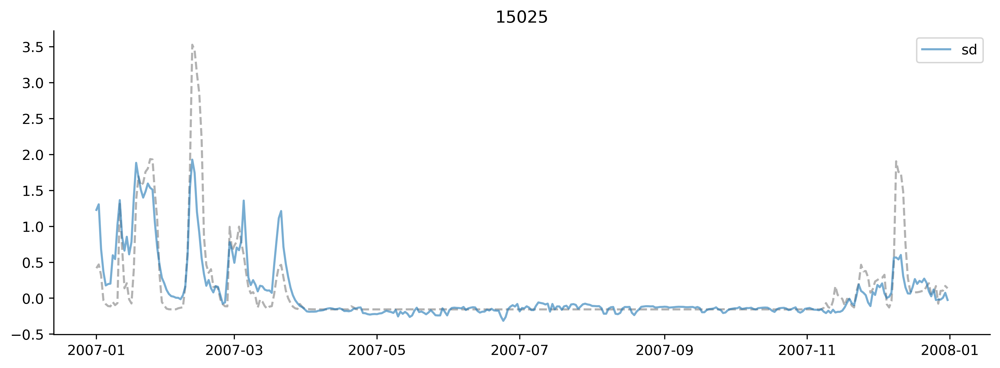

In [88]:
p = snow_models_preds["sd"]["preds"]
time = "2007"

N = 3
pixels = np.random.choice(p.station_id.values, N, replace=False)
pixels = [4003, 15023, 15025]

with plt.rc_context({"figure.dpi": 400}):
    for px in pixels:
        f, ax = plt.subplots(figsize=(12, 4))
        for ix, target_var in enumerate(["sd"]):
            preds = snow_models_preds["sd"]["preds"]
            data = preds.sel(station_id=px, time=time)

        #     f, ax = plt.subplots(figsize=(12, 4))
            ax.plot(data.time, data.obs, color="k", ls="--", alpha=0.3)
            ax.plot(data.time, data.sim, color=f"C{ix}", ls="-", alpha=0.6, label=f"{target_var}")
            ax.legend()
            sns.despine()
            ax.set_title(px)

In [89]:
data = snow_models_preds["sd"]["preds"].sel(station_id=px)
winter_time_indexes = indexes = np.argwhere((data["time.season"] == "DJF").values).flatten()

In [90]:
data

<xarray.Dataset>
Dimensions:     (time: 4017)
Coordinates:
    station_id  int64 15025
  * time        (time) datetime64[ns] 1998-01-01T00:00:30.215962624 ... 2008-...
Data variables:
    obs         (time) float32 0.8054 1.415 1.994 2.655 ... 0.4245 0.48 0.514
    sim         (time) float64 0.6125 0.7536 1.06 1.759 ... 0.3598 0.375 0.5231

In [91]:
# pxs = [9004,  8005,  7001]
# with plt.rc_context({"figure.dpi": 400}):
#     f, axs = plt.subplots(len(pxs), 1, figsize=(12, 2*len(pxs)))

# #     dim_ixs = indexes[:1]
#     sids = [int(i) for i in snowy_sids[:3].values]

#     for ix, px in enumerate(pixels):
#         ax = axs[ix]

#         data = snow_models_preds["sd"]["preds"].sel(station_id=px)
#         ax.plot(data.time, data.obs, color=f"k", ls="--", alpha=0.6, label=f"Obs")

#         ax2 = ax.twinx()
#         for dim_ix in dim_ixs:
#             snowy_cs = test_cs.sel(station_id=px)[f"dim{dim_ix}"]
#             ax2.plot(snowy_cs.time, snowy_cs, label=f"dim{dim_ix}")

#         subzeros = (ds.sel(station_id=data.station_id, time=data.time)["temperature"] < 0).values
#         zero_temp_indexes = np.argwhere(subzeros)

#         def consecutive(data, stepsize=1):
#             # https://stackoverflow.com/a/7353335/9940782
#             return np.split(data, np.where(np.diff(data) != stepsize)[0] + 1)
        
#         zero_temp_indexes
#         subzero = consecutive(zero_temp_indexes)[0]
#         for zero_ix in zero_temp_indexes:
#             time = snowy_cs.time.values[zero_ix]
#             ax.axvline(time, alpha=0.2, color="C2")

#         sns.despine()
#         ax.set_title(px)
#         if ix == 0:
#             ax.legend(loc="upper right")
#             ax2.legend(loc="lower right")


#     plt.tight_layout()
# plt.gcf().suptitle("Days when temperatures are below zero...")

In [92]:
static["gauge_name"].sel(station_id=15025)
# static["gauge_name"].sel(station_id=)

<xarray.DataArray 'gauge_name' ()>
array('Ericht at Craighall', dtype='<U19')
Coordinates:
    station_id  int64 15025

### plot error distributions

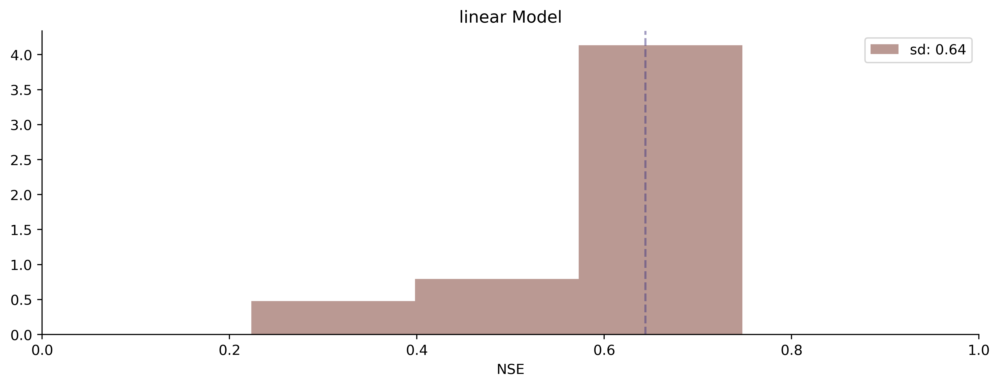

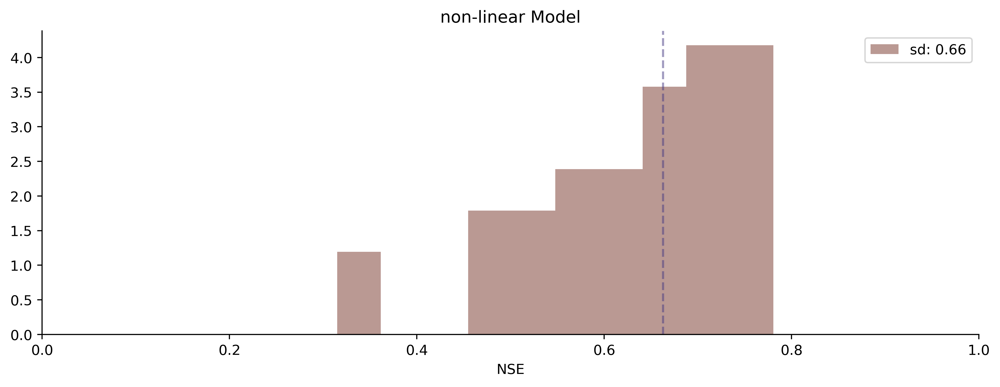

In [93]:
metric = "NSE"
for model in ["linear", "non-linear"]:
    with plt.rc_context({"figure.dpi": 400}):
        f, ax = plt.subplots(figsize=(12, 4))

        colors = sns.color_palette("viridis", n_colors=len(target_vars) + 1)
        target_var = "sd"
        if model == "linear":
            errors = snow_models_preds[target_var]["errors"]
        elif model == "non-linear":
            errors = nl_snow_models_preds[target_var]["errors"]
        nse = errors[metric]

        ax.hist(nse.where(nse > -1, -1), bins=10, density=True, label=f"{target_var}: {nse.median().values:.2f}", alpha=0.6, color="C5");
        ax.axvline(nse.median(), color=colors[ix], ls="--", alpha=0.5)

        ax.set_xlabel(metric)
        ax.set_xlim(0, 1)
        ax.legend()
        ax.set_title(f"{model} Model")
        sns.despine()

### non linear model snow

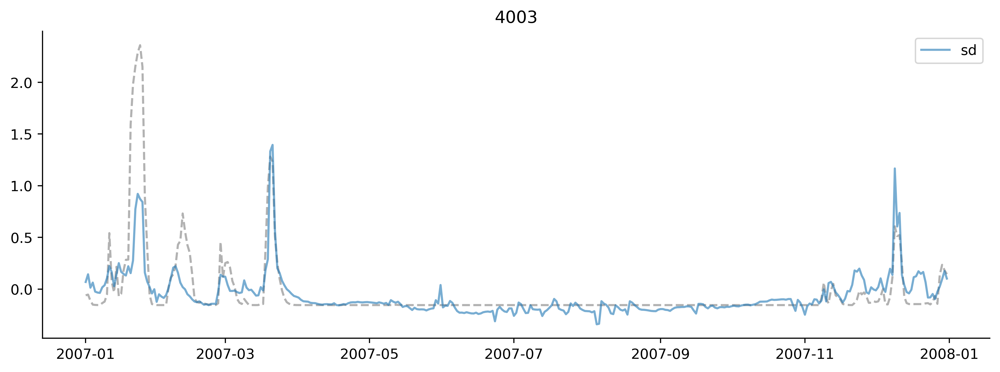

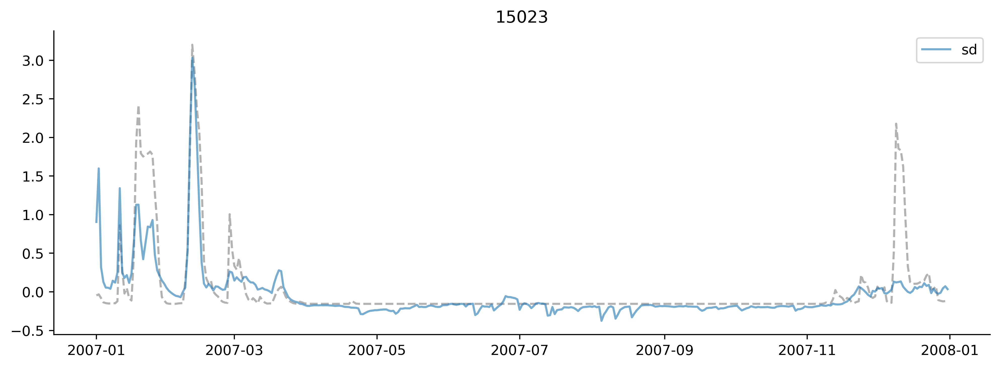

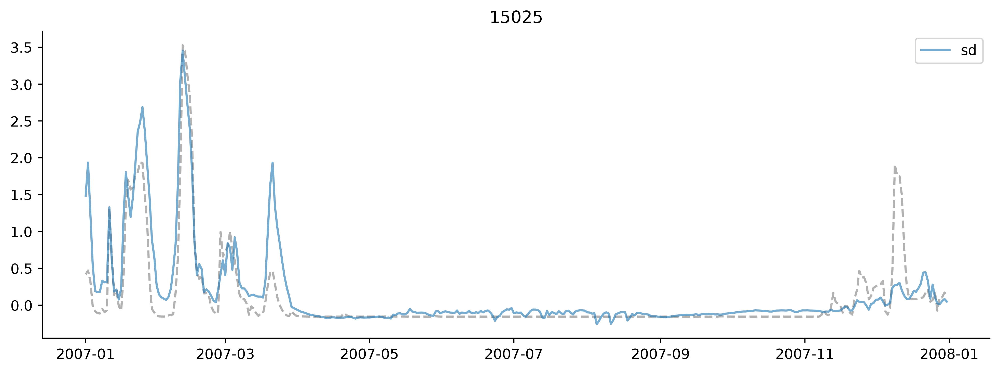

In [94]:
p = snow_models_preds["sd"]["preds"]
time = "2007"

N = 3
pixels = np.random.choice(p.station_id.values, N, replace=False)
pixels = [4003, 15023, 15025]

with plt.rc_context({"figure.dpi": 400}):
    for px in pixels:
        f, ax = plt.subplots(figsize=(12, 4))
        for ix, target_var in enumerate(["sd"]):
            preds = nl_snow_models_preds["sd"]["preds"]
            data = preds.sel(station_id=px, time=time)

        #     f, ax = plt.subplots(figsize=(12, 4))
            ax.plot(data.time, data.obs, color="k", ls="--", alpha=0.3)
            ax.plot(data.time, data.sim, color=f"C{ix}", ls="-", alpha=0.6, label=f"{target_var}")
            ax.legend()
            sns.despine()
            ax.set_title(px)

### plot the weights

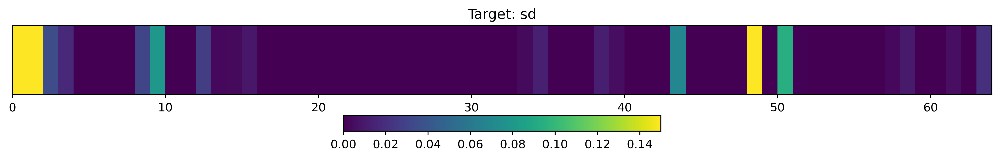

In [146]:
from scripts.cell_state.analysis import get_model_weights, plot_weights

with plt.rc_context({"figure.dpi": "400"}):
    f, ax = plt.subplots(1, 1, figsize=(12, 2))

    for ix, target_var in enumerate(["sd"]):
        model = snow_models_preds[target_var]["model"]
        w, b = get_model_weights(model)
        plot_weights(np.abs(w), kwargs={"vmin": 0.0, "vmax": 0.15}, ax=ax, cbar=True)
        ax.set_title(f"Target: {target_var}")
        ax.set_yticks([])
        ax.set_yticklabels([])
    plt.tight_layout()

### Check the sd individual cells

In [117]:
model = snow_models_preds["sd"]["model"]
w, b = get_model_weights(model)
snow_cs_ix = np.argmax(abs(w))
snow_cs_ix_second = np.argmax(np.delete(abs(w), snow_cs_ix))

In [118]:
from scripts.cell_state.timeseries_model import _round_time_to_hour
from scripts.cell_state.analysis import get_hydrological_year

snow_preds = snow_models_preds["sd"]["preds"]
snow_preds["time"] = _round_time_to_hour(snow_preds.time.values)
snow_cs = test_cs.sel(station_id=snowy_sids, time=snow_preds.time)
snow_ds = ds.sel(station_id=snowy_sids, time=snow_preds.time)

'Findhorn at Shenachie'

In [ ]:
px = 7001  # 8009  # 9004  8005  7001
time = 2008
times = ("2000", "2008")

N_cs = 2
indexes = np.argsort(abs(w))[-N_cs:][::-1]
indexes = [48, 1]

s = snow_preds["obs"].sel(time=slice(times[0], times[1]), station_id=px)
d = snow_ds["temperature"].sel(time=slice(times[0], times[1]), station_id=px)

with plt.rc_context({"figure.dpi": "400"}):
    f, ax = plt.subplots(figsize=(12, 4))
    for ix, c_ix in enumerate(indexes):
        c = snow_cs[f"dim{c_ix}"].sel(time=slice(times[0], times[1]), station_id=px) 

        ax.plot(c.time, -c, label=f"Cell State {c_ix}", color=f"C{ix}")

    ax2 = ax.twinx()
    ax2.plot(s.time, s, label="Observed Snow", color="k", ls="--", alpha=0.6)
    ax.legend(loc="upper right")
    
    ax.set_ylabel("Snow Depth [m of water equivalent]")
    ax2.set_ylabel("Raw Cell State Value")

    ax.set_title(f"{px}: {str(static['gauge_name'].sel(station_id=px).values)}");
#     sns.despine()
    ax.spines['top'].set_visible(False)


### Visualise the top N cell states?

In [99]:
N_cs = 2
indexes = np.argsort(abs(w))[-N_cs:][::-1]
train_cs[[f"dim{ix}" for ix in indexes]]

<xarray.Dataset>
Dimensions:     (station_id: 669, time: 3653)
Coordinates:
  * time        (time) datetime64[ns] 1988-01-01 1988-01-02 ... 1997-12-31
  * station_id  (station_id) int64 10002 10003 1001 101002 ... 96002 96004 97002
Data variables:
    dim48       (time, station_id) float32 0.1981 0.1852 ... 0.05552 0.09707
    dim0        (time, station_id) float32 -0.1146 -0.1323 ... 2.099 0.6825

In [100]:
snow_models_preds["sd"]["preds"]

<xarray.Dataset>
Dimensions:     (station_id: 36, time: 4017)
Coordinates:
  * station_id  (station_id) int64 4003 7001 7002 7005 ... 24003 25003 25012
  * time        (time) datetime64[ns] 1998-01-01 1998-01-02 ... 2008-12-30
Data variables:
    obs         (station_id, time) float32 -0.0139 -0.07014 ... -0.1328 -0.1134
    sim         (station_id, time) float64 -0.08591 -0.1406 ... -0.2361 -0.1765

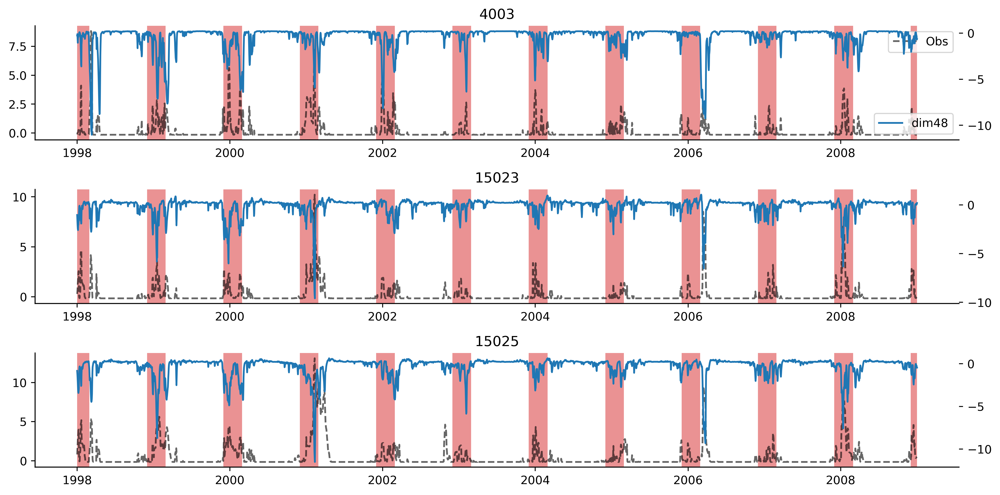

In [101]:
pxs = [9004,  8005,  7001]
with plt.rc_context({"figure.dpi": 400}):
    f, axs = plt.subplots(len(pxs), 1, figsize=(12, 2*len(pxs)))

    dim_ixs = indexes[:1]
    sids = [int(i) for i in snowy_sids[:3].values]

    for ix, px in enumerate(pixels):
        ax = axs[ix]

        data = snow_models_preds["sd"]["preds"].sel(station_id=px)
        ax.plot(data.time, data.obs, color=f"k", ls="--", alpha=0.6, label=f"Obs")

        ax2 = ax.twinx()
        for dim_ix in dim_ixs:
            snowy_cs = test_cs.sel(station_id=px)[f"dim{dim_ix}"]
            ax2.plot(snowy_cs.time, snowy_cs, label=f"dim{dim_ix}")

        # plot winter spans as background
        winter_time_indexes = np.argwhere((snowy_cs["time.season"] == "DJF").values).flatten()

        def consecutive(data, stepsize=1):
            # https://stackoverflow.com/a/7353335/9940782
            return np.split(data, np.where(np.diff(data) != stepsize)[0] + 1)

        winters = consecutive(winter_time_indexes)
        for winter in winters:
            time_min, time_max = snowy_cs.time.values[winter.min()], snowy_cs.time.values[winter.max()]
            ax.axvspan(time_min, time_max, facecolor='C3', alpha=0.5)

        sns.despine()
        ax.set_title(px)
        if ix == 0:
            ax.legend(loc="upper right")
            ax2.legend(loc="lower right")


    plt.tight_layout()

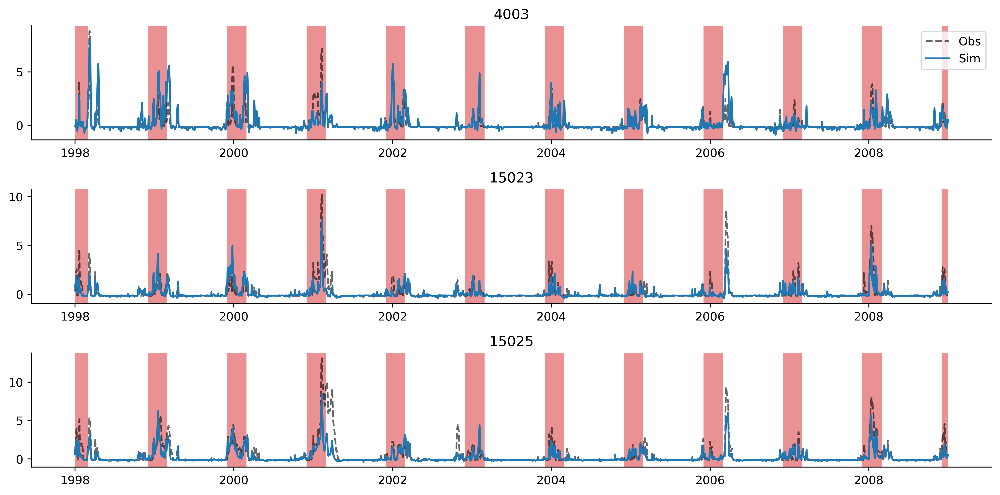

In [102]:
with plt.rc_context({"figure.dpi": 400}):
    f, axs = plt.subplots(len(pxs), 1, figsize=(12, 2*len(pxs)))

    dim_ixs = indexes[:1]
    sids = [int(i) for i in snowy_sids[:3].values]

    for ix, px in enumerate(pixels):
        ax = axs[ix]

        data = snow_models_preds["sd"]["preds"].sel(station_id=px)
        ax.plot(data.time, data.obs, color=f"k", ls="--", alpha=0.6, label=f"Obs")

        for dim_ix in dim_ixs:
            ax.plot(data.time, data.sim, label="Sim")

        # plot winter spans as background
        winter_time_indexes = np.argwhere((snowy_cs["time.season"] == "DJF").values).flatten()

        def consecutive(data, stepsize=1):
            # https://stackoverflow.com/a/7353335/9940782
            return np.split(data, np.where(np.diff(data) != stepsize)[0] + 1)

        winters = consecutive(winter_time_indexes)
        for winter in winters:
            time_min, time_max = snowy_cs.time.values[winter.min()], snowy_cs.time.values[winter.max()]
            ax.axvspan(time_min, time_max, facecolor='C3', alpha=0.5)

        sns.despine()
        ax.set_title(px)
        if ix == 0:
            ax.legend(loc="upper right")
            ax2.legend(loc="lower right")


    plt.tight_layout()

# Run forward predictions for with snow probe for non-snowy catchments

In [103]:
model = snow_models_preds["sd"]["model"]

In [104]:
snow_target_ds = era5_ds[["sd"]]
input_ds = train_cs

all_snow_train_target_ds = snow_target_ds.sel(time=np.isin(target_ds.time, train_cs.time))
all_snow_test_target_ds = snow_target_ds.sel(time=np.isin(target_ds.time, test_cs.time))

input_variables = list(train_cs.data_vars)
seq_length = 1
basin_dim = "station_id"
time_dim = "time"
if not "all_stations_snow_train_test" in globals().keys():
    all_stations_snow_train_test = create_train_test_default_dict_for_all_target_vars(
        train_cs=train_cs,
        test_cs=test_cs,
        train_target_ds=all_snow_train_target_ds,
        test_target_ds=all_snow_test_target_ds,
        input_variables=input_variables,
    )

** STARTING sd **


Extracting Data: 100%|██████████| 9516/9516 [01:07<00:00, 140.33it/s]


Merging and reshaping arrays


Extracting Data: 100%|██████████| 10467/10467 [01:14<00:00, 141.21it/s]


Merging and reshaping arrays


In [105]:
from scripts.cell_state.sklearn_models import evaluate

all_snow_preds, all_snow_errors = evaluate(model, all_stations_snow_train_test["sd"]["test"])

Calculating Errors: 100%|██████████| 667/667 [00:15<00:00, 44.42it/s, 106001]


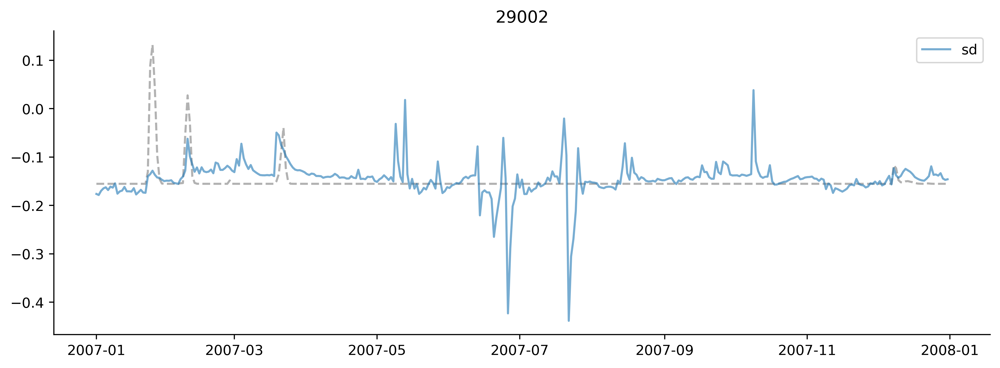

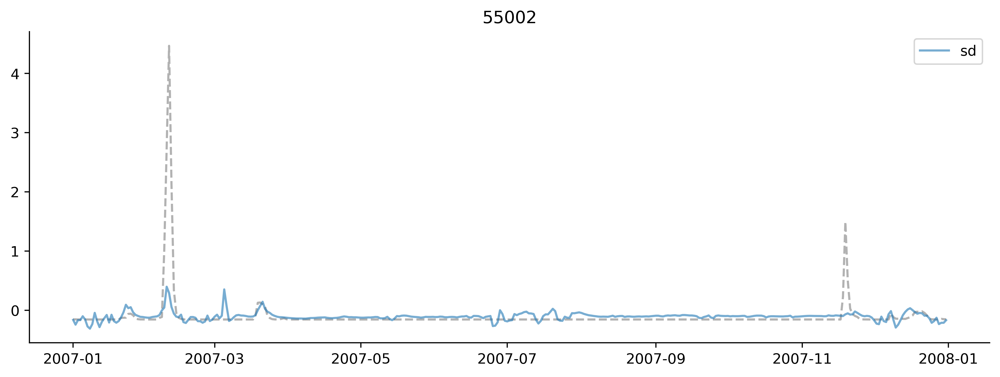

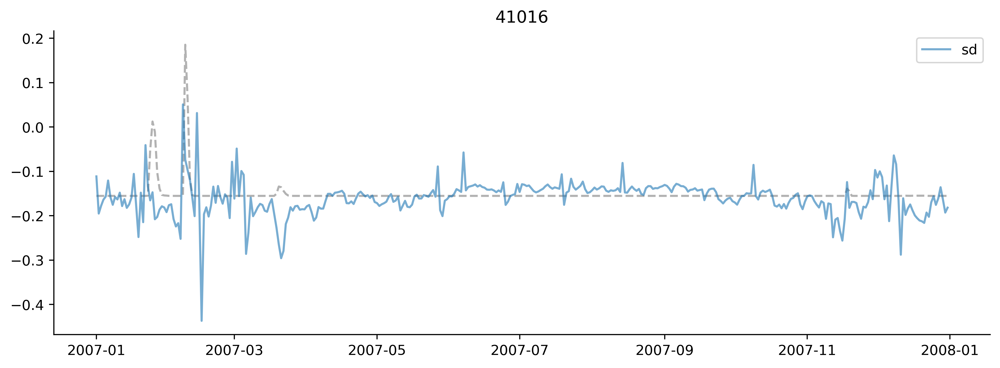

In [106]:
p = all_snow_preds
time = "2007"

N = 3
pixels = np.random.choice(p.station_id.values, N, replace=False)

with plt.rc_context({"figure.dpi": 400}):
    for px in pixels:
        f, ax = plt.subplots(figsize=(12, 4))
        for ix, target_var in enumerate(["sd"]):
            preds = all_snow_preds
            data = preds.sel(station_id=px, time=time)

        #     f, ax = plt.subplots(figsize=(12, 4))
            ax.plot(data.time, data.obs, color="k", ls="--", alpha=0.3)
            ax.plot(data.time, data.sim, color=f"C{ix}", ls="-", alpha=0.6, label=f"{target_var}")
            ax.legend()
            sns.despine()
            ax.set_title(px)

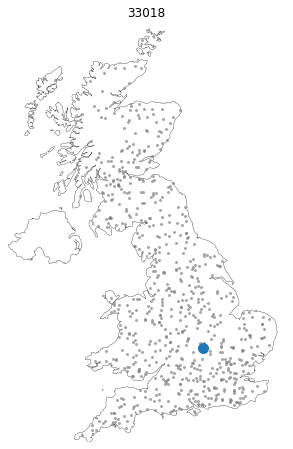

In [107]:
from scripts.geospatial import plot_spatial_location
plot_spatial_location([33018], points=points)
plt.gca().set_title(33018);

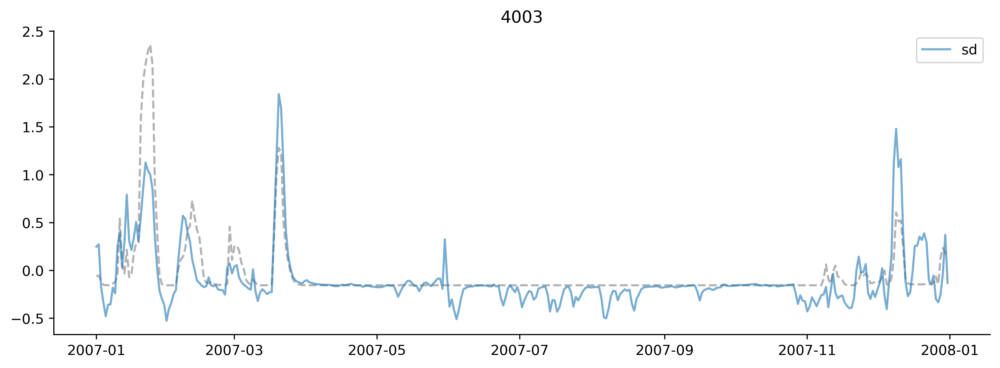

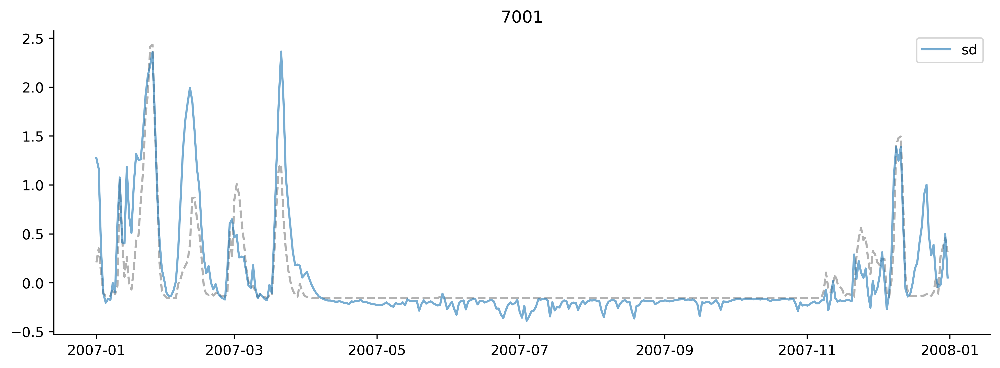

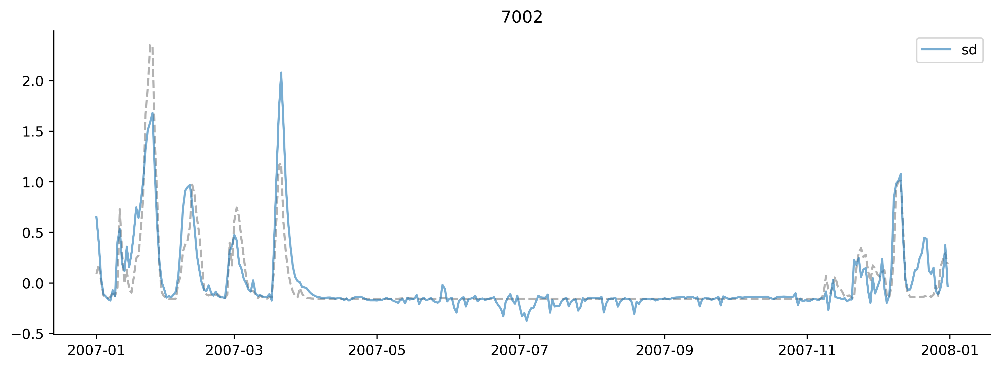

In [108]:
CLIP = False

with plt.rc_context({"figure.dpi": 400}):
    for px in [int(sid) for sid in snowy_sids][:3]:
        f, ax = plt.subplots(figsize=(12, 4))
        for ix, target_var in enumerate(["sd"]):
            preds = all_snow_preds
            data = preds.sel(station_id=px, time=time)

        #     f, ax = plt.subplots(figsize=(12, 4))
            ax.plot(data.time, data.obs, color="k", ls="--", alpha=0.3)
            ax.plot(data.time, data.sim.clip(0) if CLIP else data.sim, color=f"C{ix}", ls="-", alpha=0.6, label=f"{target_var}")
            ax.legend()
            sns.despine()
            ax.set_title(px)

<AxesSubplot:>

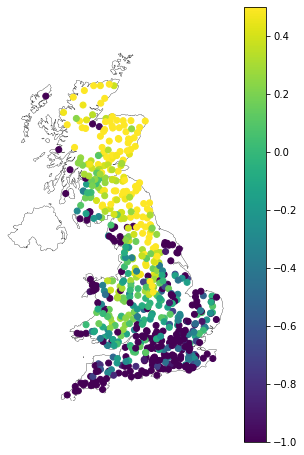

In [109]:
ax = initialise_gb_spatial_plot()
gpd.GeoDataFrame(all_snow_errors["NSE"].to_dataframe().join(points)).plot("NSE", ax=ax, vmax=0.5, vmin=-1, legend=True)

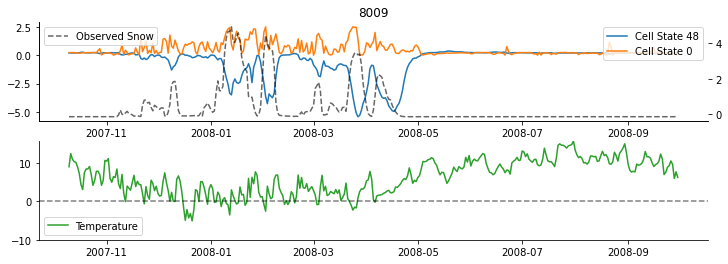

In [110]:


time = 2008
times = get_hydrological_year(time)
px = np.random.choice(snow_preds.station_id.values)
px = 8009  # 9004  8005  7001

c = snow_cs[f"dim{snow_cs_ix}"].sel(time=slice(times[0], times[1]), station_id=px)
c2 = abs(snow_cs[f"dim{snow_cs_ix_second}"].sel(time=slice(times[0], times[1]), station_id=px))


s = snow_preds["obs"].sel(time=slice(times[0], times[1]), station_id=px)
d = snow_ds["temperature"].sel(time=slice(times[0], times[1]), station_id=px)

f, axs = plt.subplots(2, 1, figsize=(12, 4))
ax = axs[0]
ax.plot(c.time, c, label=f"Cell State {snow_cs_ix}", color="C0")
ax.plot(c.time, c2, label=f"Cell State {snow_cs_ix_second}", color="C1")
ax2 = ax.twinx()
ax2.plot(s.time, s, label="Observed Snow", color="k", ls="--", alpha=0.6)
ax.legend(loc="upper right")
ax2.legend(loc="upper left")
ax.set_title(px);

ax = axs[1]
ax.plot(d.time, d, color="C2", label="Temperature")
ax.set_ylim(-10, abs(d).max())
ax.axhline(0, ls="--", color="k", alpha=0.5)
ax.legend()
sns.despine()

# Explore

# Pytorch Probe

In [111]:
assert False, "Do not run automagically"

AssertionError: Do not run automagically

In [ ]:
# from scripts.cell_state.timeseries_dataset import TimeSeriesDataset

train_dataset = TimeSeriesDataset(
    input_data=input_data,
    target_data=target_data,
    target_variable="swvl1",
    input_variables=input_variables,
    seq_length=seq_length,
    basin_dim=basin_dim,
    time_dim=time_dim,
    desc="Creating Train Samples",
)

test_dataset = TimeSeriesDataset(
    input_data=test_input_data,
    target_data=test_target_data,
    target_variable="swvl1",
    input_variables=input_variables,
    seq_length=seq_length,
    basin_dim=basin_dim,
    time_dim=time_dim,
    desc="Creating Test Samples",
)

In [ ]:
from torch.utils.data import DataLoader
import torch
from torch import nn
from scripts.cell_state.cell_state_model import LinearModel

model = LinearModel(D_in=64)

In [ ]:
batch_size = int(1e4)
num_workers = 0
learning_rate = 1e-4
l2_penalty = 0

train_loader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=num_workers,
)
test_loader = DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=num_workers,
)
print(len(train_loader))
print(len(test_loader))

In [ ]:
# GET optimizer
optimizer = torch.optim.Adam(
    model.parameters(), lr=learning_rate, weight_decay=l2_penalty
)

# GET loss
loss_fn = nn.MSELoss()

n_epochs = 10

### Train the linear model

In [ ]:
from tqdm import tqdm


l1_ratio = 0.15
epoch_losses = []
mean_epoch_loss = 9999
for epoch in range(n_epochs):
    losses = []
    pbar = tqdm(train_loader, desc=f"Epoch {epoch}")
    for data in pbar:
        pbar.set_postfix_str(f"{mean_epoch_loss:.2f}")
        y_pred = model(data)
        y = data["y"].squeeze(1)

        # calculate loss
        loss = loss_fn(y_pred, y)

        # add regularisation terms
        # l1 loss-penalty (1st order magnitude, vector of weights)
        loss = loss + (regularization_lambda * torch.norm(torch.cat([param.view(-1) for param in model.parameters()]), p=1))
        # l2 loss-penalty (2nd order magnitude, vector of weights)
        loss = loss + ((1 - regularization_lambda) * torch.square(torch.norm(torch.cat([param.view(-1) for param in model.parameters()]), p=2)))
    
        losses.append(loss.detach().numpy())
        
        # train/update the weight
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    
    mean_epoch_loss = float(np.mean(losses))
    epoch_losses.append(mean_epoch_loss)

In [ ]:
plt.plot(epoch_losses)

In [ ]:
ws = [p for p in model.parameters()][0].detach().numpy()
b = [p for p in model.parameters()][1].detach().numpy()

ext = np.concatenate([ws, b])
f, ax = plt.subplots(1, 1, figsize=(12, 2*1))
plot_weights(np.abs(ext), kwargs={"vmin": 0.0, "vmax": 0.3}, ax=ax, cbar=False)

In [ ]:
from scripts.cell_state.timeseries_model import _round_time_to_hour
from scripts.cell_state.cell_state_model import to_xarray

# def evaluate(test_loader: Dataloader) -> xr.Dataset:
predictions = defaultdict(list)   # : DefaultDict[str, List]

with torch.no_grad():
    for data in tqdm(test_loader, "Evaluation Forward Pass"):
        y_hat = model(data).squeeze()
        y = data["y"].squeeze()
        basin, time = data["meta"]["spatial_unit"].numpy(), data["meta"]["time"].numpy()
        
        #  Coords / Dimensions
        predictions["time"].extend(_round_time_to_hour(pd.to_datetime([t[0] for t in time.astype("datetime64[ns]")])))
        predictions["station_id"].extend(basin)

        # Variables
        predictions["y_hat"].extend(y_hat.detach().cpu().numpy().flatten())
        predictions["y"].extend(y.detach().cpu().numpy().flatten())


In [ ]:
model_p = to_xarray(predictions)

In [ ]:
f, ax = plt.subplots(figsize=(12, 4))
data = model_p.isel(station_id=100).drop("station_id")
ax.plot(data.time, data["y_hat"], color="C0", label="sim")
ax.plot(data.time, data["y"], color="k", label="obs", alpha=0.5, ls="--")
# data.to_dataframe().drop("station_id", axis=1).plot(ax=ax)
sns.despine()

# What is going on with SWL2?

In [ ]:
_ds = xr.open_dataset(data_dir / "extended_camels_data.nc")

px = np.random.choice(_ds.station_id.values)
f, ax = plt.subplots(figsize=(12, 4))
_ds["swvl1"].sel(station_id=px).plot(ax=ax, label="swvl1", alpha=0.6)
_ds["swvl2"].sel(station_id=px).plot(ax=ax, label="swvl2", alpha=0.6)
# _ds["swvl3"].sel(station_id=px).plot(ax=ax, label="swvl3", alpha=0.6)
# _ds["swvl4"].sel(station_id=px).plot(ax=ax, label="swvl4", alpha=0.6)
plt.legend()
sns.despine()

# Marginalia

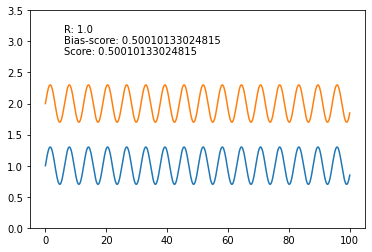

In [258]:
import numpy as np
from math import sqrt
from scipy.stats import pearsonr
import matplotlib.pyplot as plt
 
x = np.linspace(0, 100, 10000)
a = np.sin(x) * 0.3 + 1
b = np.sin(x) * 0.3 + 2
 
r = pearsonr(a, b)[0]
bias_ratio = np.mean(a) / np.mean(b)
 
score = 1 - sqrt((r - 1) ** 2 + (bias_ratio - 1) ** 2)
 
fig, ax = plt.subplots(1, 1)
ax.plot(x, a)
ax.plot(x, b)
ax.set_ylim(0, 3.5)
ax.text(0.1, 0.9, f"R: {r}", transform=ax.transAxes)
ax.text(0.1, 0.85, f"Bias-score: {bias_ratio}", transform=ax.transAxes)
ax.text(0.1, 0.8, f"Score: {score}", transform=ax.transAxes)
plt.show()


In [ ]:
def to_pickle(obj, file):
    import pickle
    pickle.dump(obj, file.open("wb"))

In [260]:
var_ = "swvl1"
all_models_preds[var_]["model"]  # (data_dir / f"CONCEPT/{var_}_model.pkl")
all_models_preds[var_]["preds"] # .to_netcdf(data_dir / f"CONCEPT/{var_}_preds.nc")
all_models_preds[var_]["errors"] # .to_netcdf(data_dir / f"CONCEPT/{var_}_errors.nc")

{'model': SGDRegressor(alpha=0.01, early_stopping=True, loss='huber', n_iter_no_change=3,
              penalty='elasticnet', random_state=100, verbose=1),
 'preds': <xarray.Dataset>
 Dimensions:     (station_id: 667, time: 4017)
 Coordinates:
   * station_id  (station_id) int64 1001 2001 2002 3003 ... 101002 102001 106001
   * time        (time) datetime64[ns] 1998-01-01T00:00:30.215962624 ... 2008-...
 Data variables:
     obs         (station_id, time) float32 1.321 1.284 1.411 ... 3.418 3.387
     sim         (station_id, time) float64 1.285 1.318 1.35 ... 2.931 2.896,
 'errors': <xarray.Dataset>
 Dimensions:     (station_id: 667)
 Coordinates:
   * station_id  (station_id) int64 1001 2001 2002 3003 ... 101002 102001 106001
 Data variables:
     Alpha-NSE   (station_id) float64 0.7895 0.5885 0.5237 ... 0.6479 0.899
     Beta-NSE    (station_id) float64 0.286 -6.088 -1.922 ... 1.261 0.1766 -1.461
     NSE         (station_id) float64 0.6378 -36.45 -3.124 ... 0.7004 -1.653
     Pears

In [265]:
(data_dir / "CONCEPT").mkdir(exist_ok=True)
(data_dir / "CONCEPT")

PosixPath('/datadrive/data/CONCEPT')

In [266]:
pickle.dump

<function _pickle.dump(obj, file, protocol=None, *, fix_imports=True, buffer_callback=None)>

In [267]:
run_dir

PosixPath('/datadrive/data/runs/complexity_AZURE/hs_064_0306_205514')